Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [1]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys
import random

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/tuning/'
sys.path.append(root)

from ampis import data_utils, visualize, analyze
from ampis.applications import powder
from ampis.structures import InstanceSet
from ampis.visualize import display_iset



random.seed(1)
%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [2]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('batch_jobs', 'SALAS_Rep', 'satellite_training.json')  # path to training data
json_path_val = Path('batch_jobs', 'SALAS_Rep', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [3]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

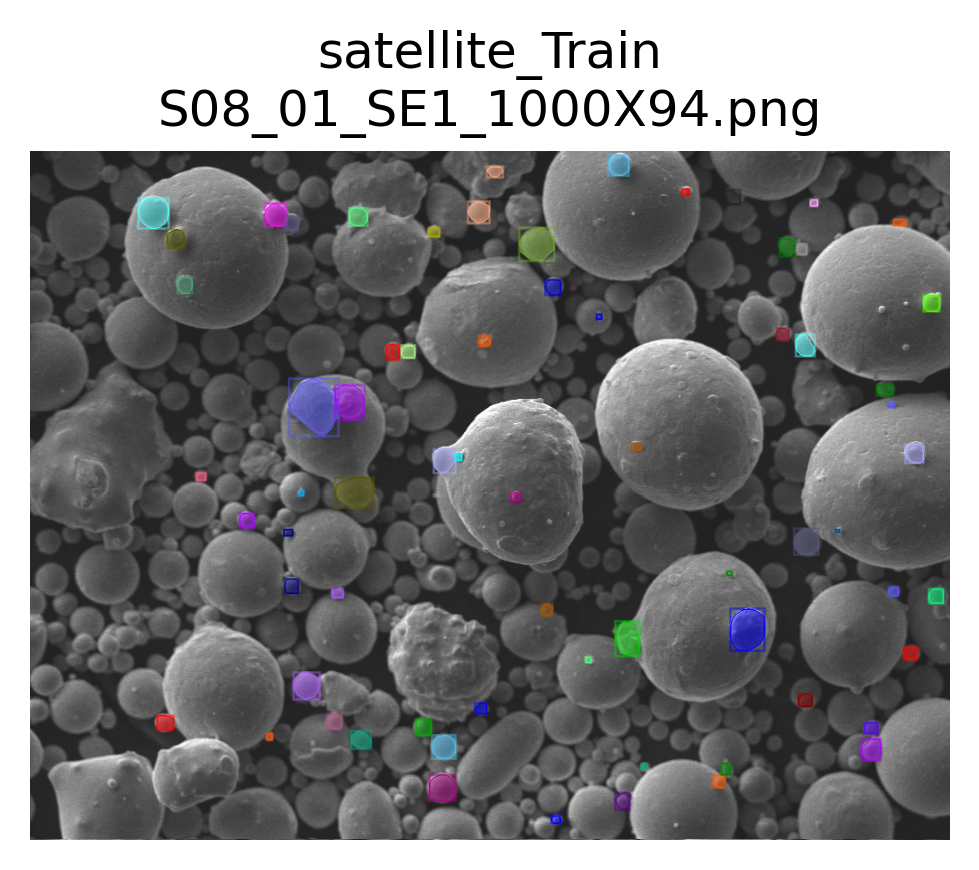

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 68


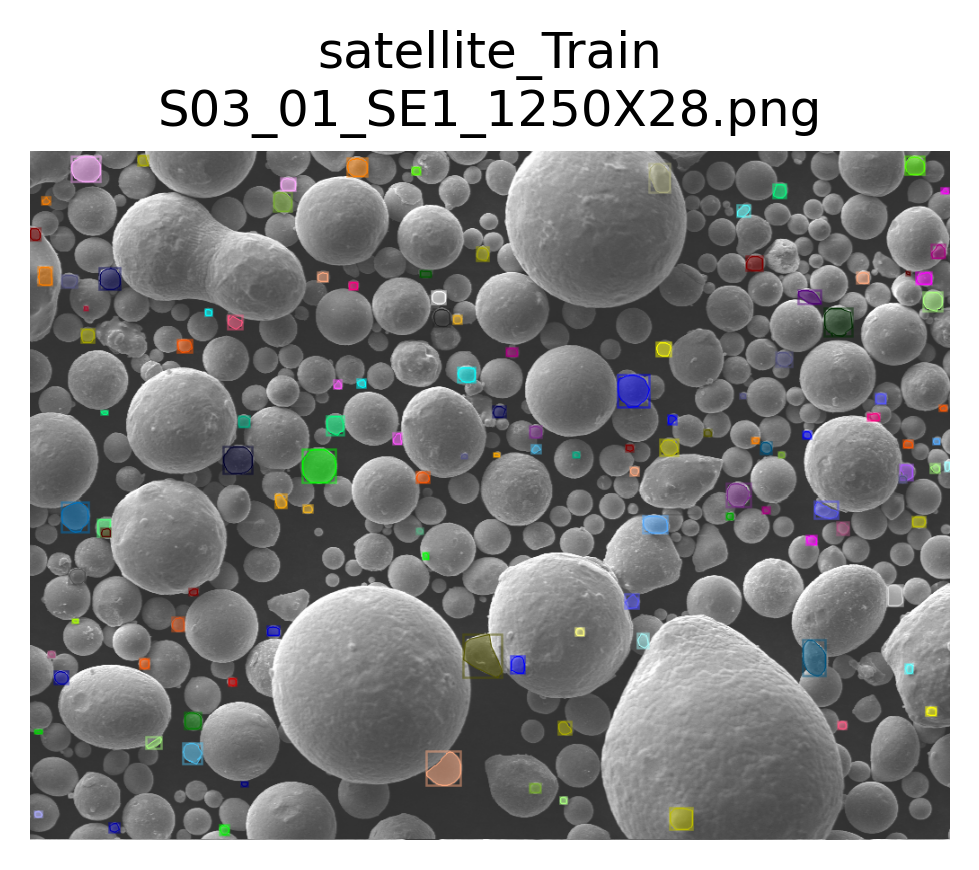

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 123


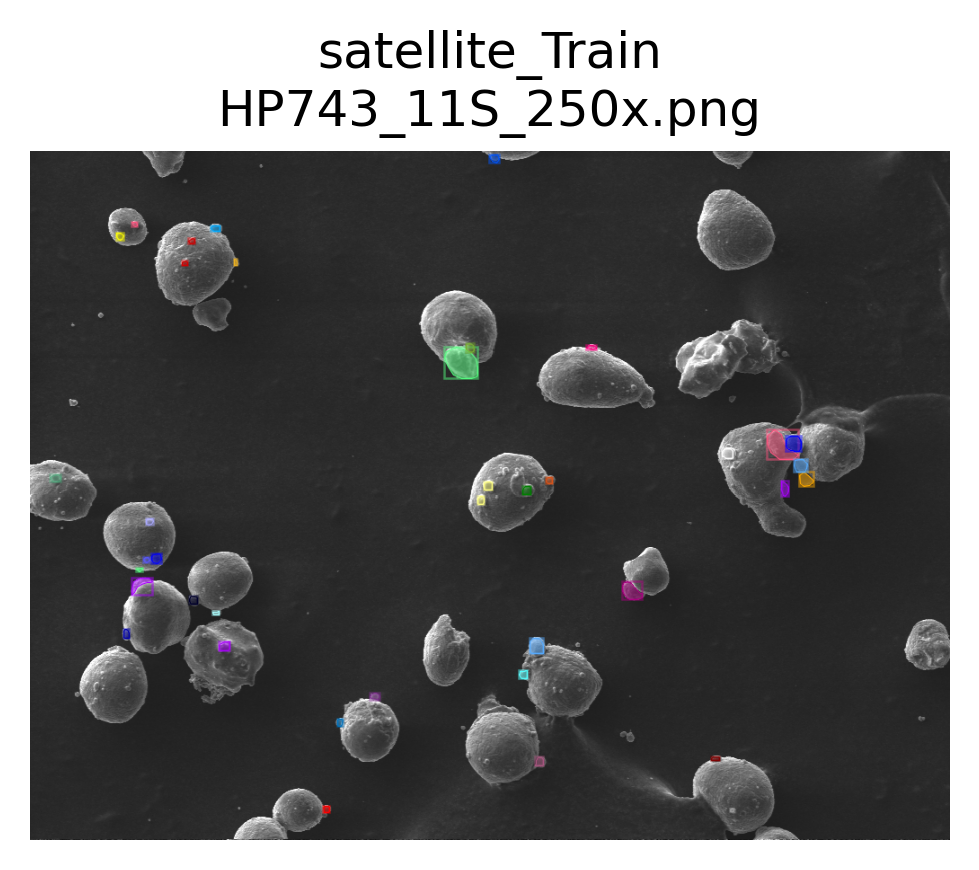

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 39


In [4]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)
#To view annotations on the entire dataset and not just 3 random instances, uncomment the following code
#for i in DatasetCatalog.get(dataset_train):
    #visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

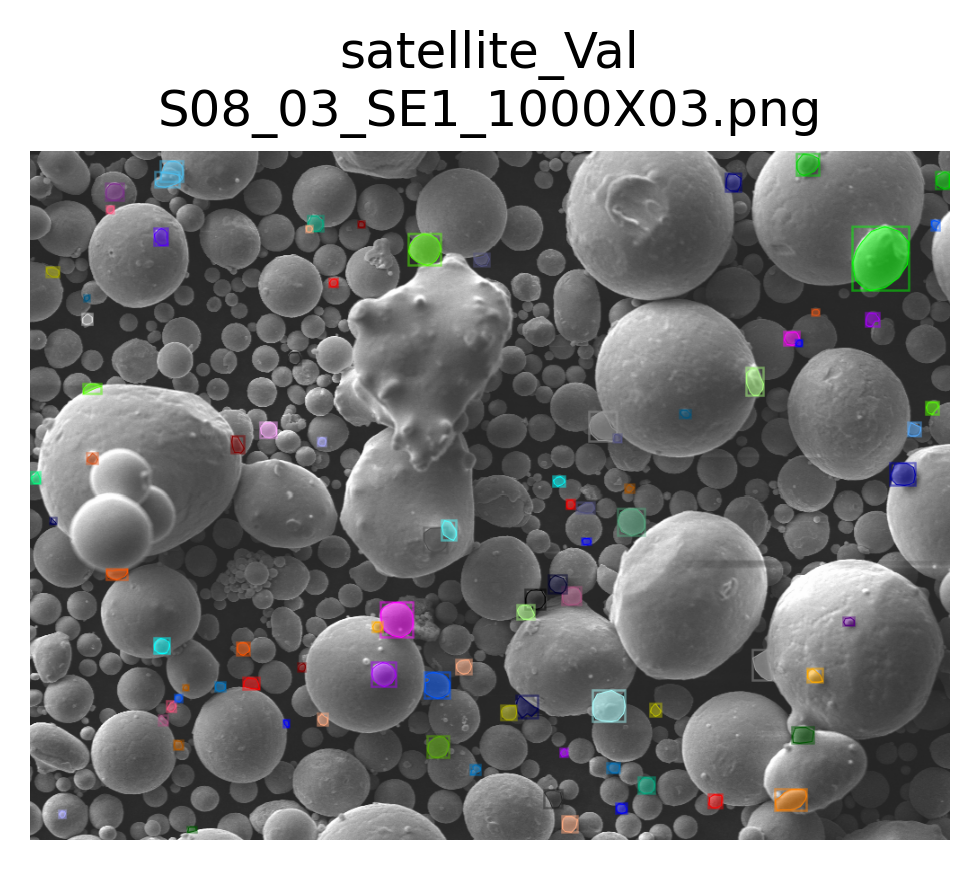

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


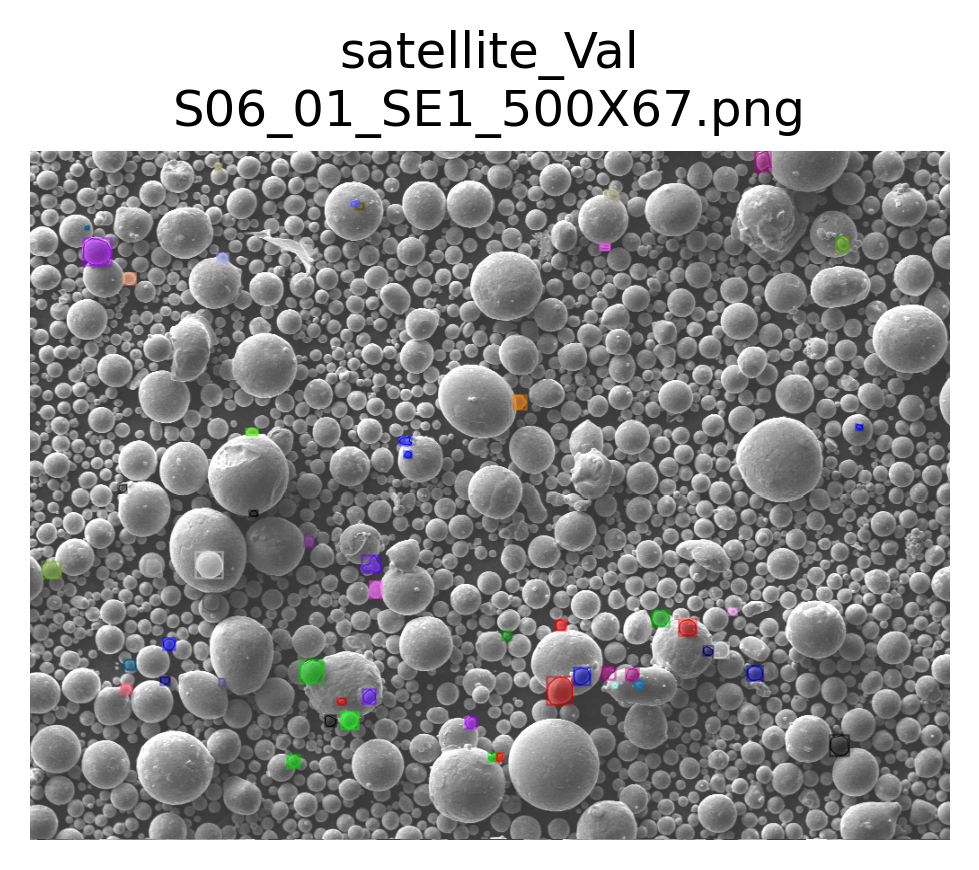

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


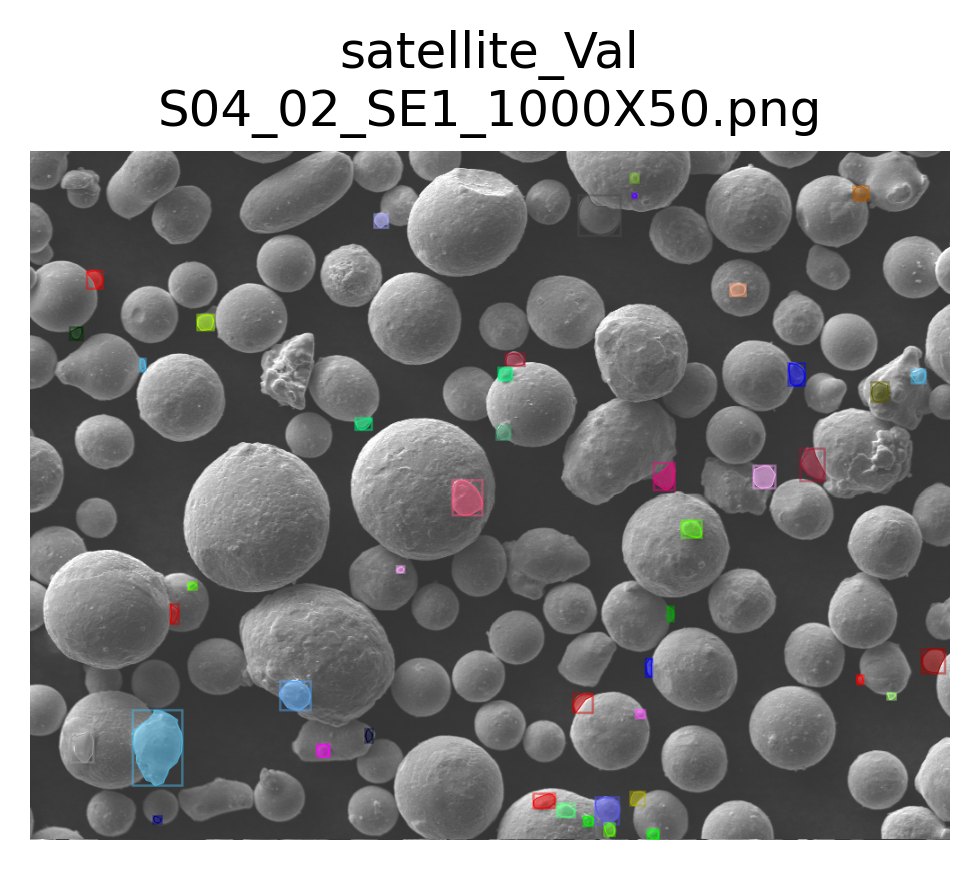

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


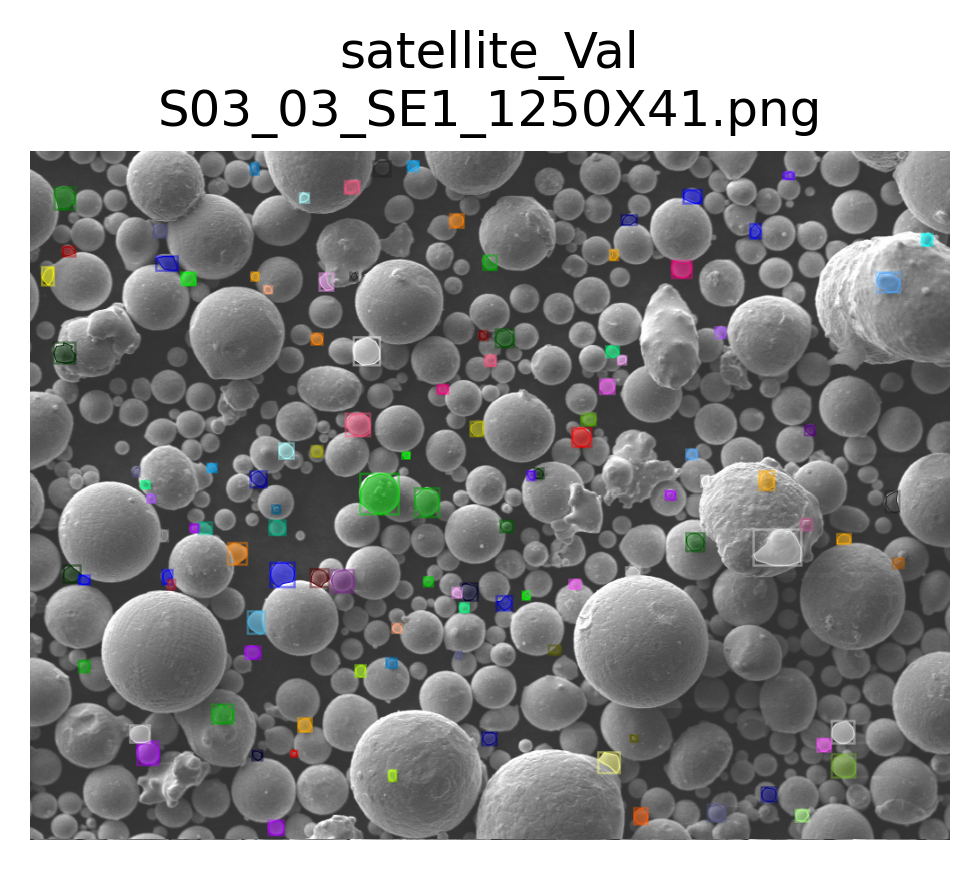

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


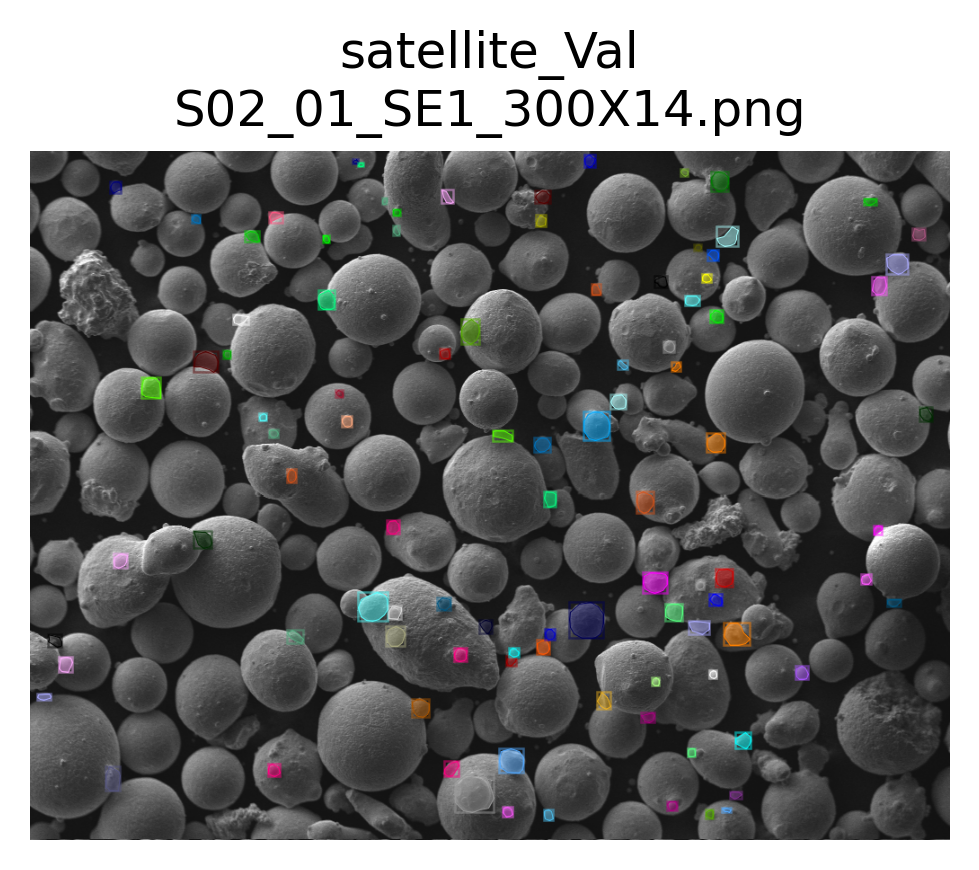

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


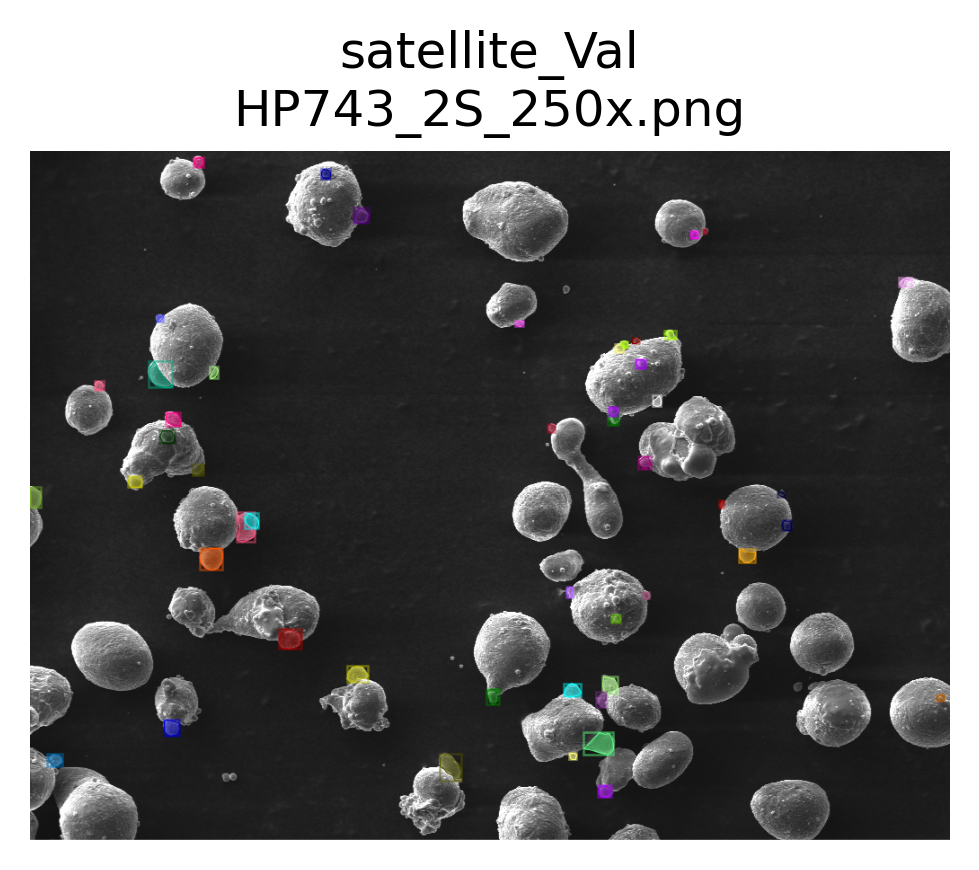

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [5]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [6]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 1000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path('DEMO_TEST'))
cfg.SEED = 1
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


In [7]:
print('--------------------------------')
print(cfg.SOLVER.BASE_LR)
print(cfg.SOLVER.WEIGHT_DECAY)
print(cfg.MODEL.RETINANET.SCORE_THRESH_TEST)
print(cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST)
print(cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH)
print(cfg.MODEL.ROI_HEADS.NUM_CLASSES)
print(cfg.SOLVER.IMS_PER_BATCH) 

--------------------------------
0.02
0.0001
0.5
0.5
0.5
1
1


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [8]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[09/17 13:04:13 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[09/17 13:04:13 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[09/17 13:04:13 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| satellite  | 1412         |
|            |              |
[09/17 13:04:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[09/17 13:04:13 d2.data.build]: Using training sampler TrainingSampler
[09/17 13:04:13 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[09/17 13:04:13 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [09/17 13:04:13 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.


/jet/home/sprice/.local/lib/python3.8/site-packages/torch/utils/data/dataloader.py:474: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 1, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/17 13:04:13 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[09/17 13:04:13 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:-------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w} | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*  

[09/17 13:04:48 d2.utils.events]:  eta: 0:11:32  iter: 219  total_loss: 1.872  loss_cls: 0.2831  loss_box_reg: 0.4753  loss_mask: 0.3434  loss_rpn_cls: 0.2678  loss_rpn_loc: 0.4646  time: 0.1451  data_time: 0.0160  lr: 0.0043956  max_mem: 1823M
[09/17 13:04:51 d2.utils.events]:  eta: 0:11:30  iter: 239  total_loss: 1.684  loss_cls: 0.2135  loss_box_reg: 0.3824  loss_mask: 0.3461  loss_rpn_cls: 0.2749  loss_rpn_loc: 0.4674  time: 0.1451  data_time: 0.0157  lr: 0.0047952  max_mem: 1823M
[09/17 13:04:54 d2.utils.events]:  eta: 0:11:29  iter: 259  total_loss: 1.866  loss_cls: 0.2972  loss_box_reg: 0.5194  loss_mask: 0.3319  loss_rpn_cls: 0.2479  loss_rpn_loc: 0.5053  time: 0.1457  data_time: 0.0163  lr: 0.0051948  max_mem: 1823M
[09/17 13:04:57 d2.utils.events]:  eta: 0:11:27  iter: 279  total_loss: 1.735  loss_cls: 0.2317  loss_box_reg: 0.3779  loss_mask: 0.3153  loss_rpn_cls: 0.2809  loss_rpn_loc: 0.5403  time: 0.1460  data_time: 0.0165  lr: 0.0055944  max_mem: 1823M
[09/17 13:05:00 d2.u

[09/17 13:06:34 d2.utils.events]:  eta: 0:10:44  iter: 879  total_loss: 1.472  loss_cls: 0.1627  loss_box_reg: 0.2718  loss_mask: 0.2401  loss_rpn_cls: 0.2283  loss_rpn_loc: 0.5001  time: 0.1563  data_time: 0.0170  lr: 0.017582  max_mem: 1823M
[09/17 13:06:37 d2.utils.events]:  eta: 0:10:42  iter: 899  total_loss: 1.519  loss_cls: 0.2015  loss_box_reg: 0.368  loss_mask: 0.2328  loss_rpn_cls: 0.2174  loss_rpn_loc: 0.4468  time: 0.1564  data_time: 0.0177  lr: 0.017982  max_mem: 1823M
[09/17 13:06:40 d2.utils.events]:  eta: 0:10:39  iter: 919  total_loss: 1.504  loss_cls: 0.1869  loss_box_reg: 0.3599  loss_mask: 0.2368  loss_rpn_cls: 0.2397  loss_rpn_loc: 0.4691  time: 0.1564  data_time: 0.0182  lr: 0.018382  max_mem: 1823M
[09/17 13:06:43 d2.utils.events]:  eta: 0:10:36  iter: 939  total_loss: 1.379  loss_cls: 0.1931  loss_box_reg: 0.3602  loss_mask: 0.2304  loss_rpn_cls: 0.179  loss_rpn_loc: 0.452  time: 0.1565  data_time: 0.0177  lr: 0.018781  max_mem: 1823M
[09/17 13:06:47 d2.utils.ev

[09/17 13:08:24 d2.utils.events]:  eta: 0:09:24  iter: 1539  total_loss: 1.41  loss_cls: 0.2141  loss_box_reg: 0.433  loss_mask: 0.2101  loss_rpn_cls: 0.1497  loss_rpn_loc: 0.4141  time: 0.1602  data_time: 0.0179  lr: 0.02  max_mem: 1823M
[09/17 13:08:28 d2.utils.events]:  eta: 0:09:20  iter: 1559  total_loss: 1.308  loss_cls: 0.1865  loss_box_reg: 0.3906  loss_mask: 0.193  loss_rpn_cls: 0.16  loss_rpn_loc: 0.3922  time: 0.1602  data_time: 0.0173  lr: 0.02  max_mem: 1823M
[09/17 13:08:31 d2.utils.events]:  eta: 0:09:17  iter: 1579  total_loss: 1.336  loss_cls: 0.1789  loss_box_reg: 0.3686  loss_mask: 0.2043  loss_rpn_cls: 0.1445  loss_rpn_loc: 0.3874  time: 0.1602  data_time: 0.0177  lr: 0.02  max_mem: 1823M
[09/17 13:08:34 d2.utils.events]:  eta: 0:09:13  iter: 1599  total_loss: 1.336  loss_cls: 0.1805  loss_box_reg: 0.3863  loss_mask: 0.1956  loss_rpn_cls: 0.148  loss_rpn_loc: 0.4016  time: 0.1602  data_time: 0.0169  lr: 0.02  max_mem: 1823M
[09/17 13:08:37 d2.utils.events]:  eta: 0:

[09/17 13:10:14 d2.utils.events]:  eta: 0:07:38  iter: 2199  total_loss: 1.224  loss_cls: 0.1898  loss_box_reg: 0.3912  loss_mask: 0.1847  loss_rpn_cls: 0.1085  loss_rpn_loc: 0.3429  time: 0.1614  data_time: 0.0182  lr: 0.02  max_mem: 1823M
[09/17 13:10:18 d2.utils.events]:  eta: 0:07:35  iter: 2219  total_loss: 1.248  loss_cls: 0.2101  loss_box_reg: 0.3966  loss_mask: 0.1862  loss_rpn_cls: 0.1264  loss_rpn_loc: 0.3328  time: 0.1616  data_time: 0.0183  lr: 0.02  max_mem: 1823M
[09/17 13:10:22 d2.utils.events]:  eta: 0:07:32  iter: 2239  total_loss: 1.189  loss_cls: 0.1832  loss_box_reg: 0.3631  loss_mask: 0.1748  loss_rpn_cls: 0.1382  loss_rpn_loc: 0.333  time: 0.1618  data_time: 0.0193  lr: 0.02  max_mem: 1823M
[09/17 13:10:25 d2.utils.events]:  eta: 0:07:29  iter: 2259  total_loss: 1.196  loss_cls: 0.1715  loss_box_reg: 0.3436  loss_mask: 0.1914  loss_rpn_cls: 0.1091  loss_rpn_loc: 0.3373  time: 0.1619  data_time: 0.0180  lr: 0.02  max_mem: 1823M
[09/17 13:10:28 d2.utils.events]:  et

[09/17 13:12:04 d2.utils.events]:  eta: 0:05:50  iter: 2859  total_loss: 1.141  loss_cls: 0.1725  loss_box_reg: 0.3667  loss_mask: 0.1842  loss_rpn_cls: 0.1045  loss_rpn_loc: 0.2829  time: 0.1624  data_time: 0.0181  lr: 0.02  max_mem: 1823M
[09/17 13:12:08 d2.utils.events]:  eta: 0:05:47  iter: 2879  total_loss: 1.159  loss_cls: 0.1771  loss_box_reg: 0.3705  loss_mask: 0.1759  loss_rpn_cls: 0.1045  loss_rpn_loc: 0.3216  time: 0.1625  data_time: 0.0178  lr: 0.02  max_mem: 1823M
[09/17 13:12:11 d2.utils.events]:  eta: 0:05:44  iter: 2899  total_loss: 1.196  loss_cls: 0.1813  loss_box_reg: 0.3683  loss_mask: 0.1819  loss_rpn_cls: 0.0949  loss_rpn_loc: 0.3372  time: 0.1625  data_time: 0.0178  lr: 0.02  max_mem: 1823M
[09/17 13:12:14 d2.utils.events]:  eta: 0:05:41  iter: 2919  total_loss: 1.152  loss_cls: 0.1757  loss_box_reg: 0.3739  loss_mask: 0.1737  loss_rpn_cls: 0.111  loss_rpn_loc: 0.3218  time: 0.1625  data_time: 0.0184  lr: 0.02  max_mem: 1823M
[09/17 13:12:18 d2.utils.events]:  et

[09/17 13:13:54 d2.utils.events]:  eta: 0:04:02  iter: 3519  total_loss: 1.137  loss_cls: 0.1737  loss_box_reg: 0.3745  loss_mask: 0.1759  loss_rpn_cls: 0.09491  loss_rpn_loc: 0.3397  time: 0.1628  data_time: 0.0174  lr: 0.02  max_mem: 1823M
[09/17 13:13:58 d2.utils.events]:  eta: 0:03:59  iter: 3539  total_loss: 1.077  loss_cls: 0.1622  loss_box_reg: 0.3487  loss_mask: 0.167  loss_rpn_cls: 0.09422  loss_rpn_loc: 0.2976  time: 0.1628  data_time: 0.0182  lr: 0.02  max_mem: 1823M
[09/17 13:14:01 d2.utils.events]:  eta: 0:03:55  iter: 3559  total_loss: 1.081  loss_cls: 0.1623  loss_box_reg: 0.359  loss_mask: 0.1715  loss_rpn_cls: 0.09059  loss_rpn_loc: 0.3024  time: 0.1629  data_time: 0.0187  lr: 0.02  max_mem: 1823M
[09/17 13:14:04 d2.utils.events]:  eta: 0:03:52  iter: 3579  total_loss: 1.077  loss_cls: 0.1549  loss_box_reg: 0.3511  loss_mask: 0.1659  loss_rpn_cls: 0.09163  loss_rpn_loc: 0.2842  time: 0.1629  data_time: 0.0172  lr: 0.02  max_mem: 1823M
[09/17 13:14:08 d2.utils.events]: 

[09/17 13:15:46 d2.utils.events]:  eta: 0:02:15  iter: 4179  total_loss: 1.029  loss_cls: 0.1497  loss_box_reg: 0.3334  loss_mask: 0.1709  loss_rpn_cls: 0.09808  loss_rpn_loc: 0.287  time: 0.1635  data_time: 0.0178  lr: 0.02  max_mem: 1823M
[09/17 13:15:49 d2.utils.events]:  eta: 0:02:11  iter: 4199  total_loss: 0.995  loss_cls: 0.1423  loss_box_reg: 0.3308  loss_mask: 0.1555  loss_rpn_cls: 0.08579  loss_rpn_loc: 0.2839  time: 0.1635  data_time: 0.0177  lr: 0.02  max_mem: 1823M
[09/17 13:15:52 d2.utils.events]:  eta: 0:02:08  iter: 4219  total_loss: 1.094  loss_cls: 0.1323  loss_box_reg: 0.3219  loss_mask: 0.1619  loss_rpn_cls: 0.1001  loss_rpn_loc: 0.3156  time: 0.1635  data_time: 0.0172  lr: 0.02  max_mem: 1823M
[09/17 13:15:56 d2.utils.events]:  eta: 0:02:05  iter: 4239  total_loss: 1.034  loss_cls: 0.151  loss_box_reg: 0.3423  loss_mask: 0.158  loss_rpn_cls: 0.09317  loss_rpn_loc: 0.2843  time: 0.1635  data_time: 0.0173  lr: 0.02  max_mem: 1823M
[09/17 13:15:59 d2.utils.events]:  e

[09/17 13:17:34 d2.utils.events]:  eta: 0:00:26  iter: 4839  total_loss: 0.994  loss_cls: 0.1361  loss_box_reg: 0.3229  loss_mask: 0.1524  loss_rpn_cls: 0.09057  loss_rpn_loc: 0.2848  time: 0.1635  data_time: 0.0179  lr: 0.02  max_mem: 1823M
[09/17 13:17:38 d2.utils.events]:  eta: 0:00:23  iter: 4859  total_loss: 0.9852  loss_cls: 0.1401  loss_box_reg: 0.312  loss_mask: 0.1532  loss_rpn_cls: 0.08027  loss_rpn_loc: 0.2734  time: 0.1635  data_time: 0.0177  lr: 0.02  max_mem: 1823M
[09/17 13:17:41 d2.utils.events]:  eta: 0:00:19  iter: 4879  total_loss: 0.988  loss_cls: 0.1402  loss_box_reg: 0.3284  loss_mask: 0.1469  loss_rpn_cls: 0.09332  loss_rpn_loc: 0.2636  time: 0.1635  data_time: 0.0173  lr: 0.02  max_mem: 1823M
[09/17 13:17:44 d2.utils.events]:  eta: 0:00:16  iter: 4899  total_loss: 0.9133  loss_cls: 0.1463  loss_box_reg: 0.3045  loss_mask: 0.1495  loss_rpn_cls: 0.07759  loss_rpn_loc: 0.2626  time: 0.1635  data_time: 0.0176  lr: 0.02  max_mem: 1823M
[09/17 13:17:47 d2.utils.events

# Creating Predictor Object
We can create a predictor object with the configurations established above and the weights that were just created

In [10]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.

predictor = DefaultPredictor(cfg)  # create predictor object

# Visualizing model predictions


We can view predictions on the entire train and validation set

Dataset: satellite_Train
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png


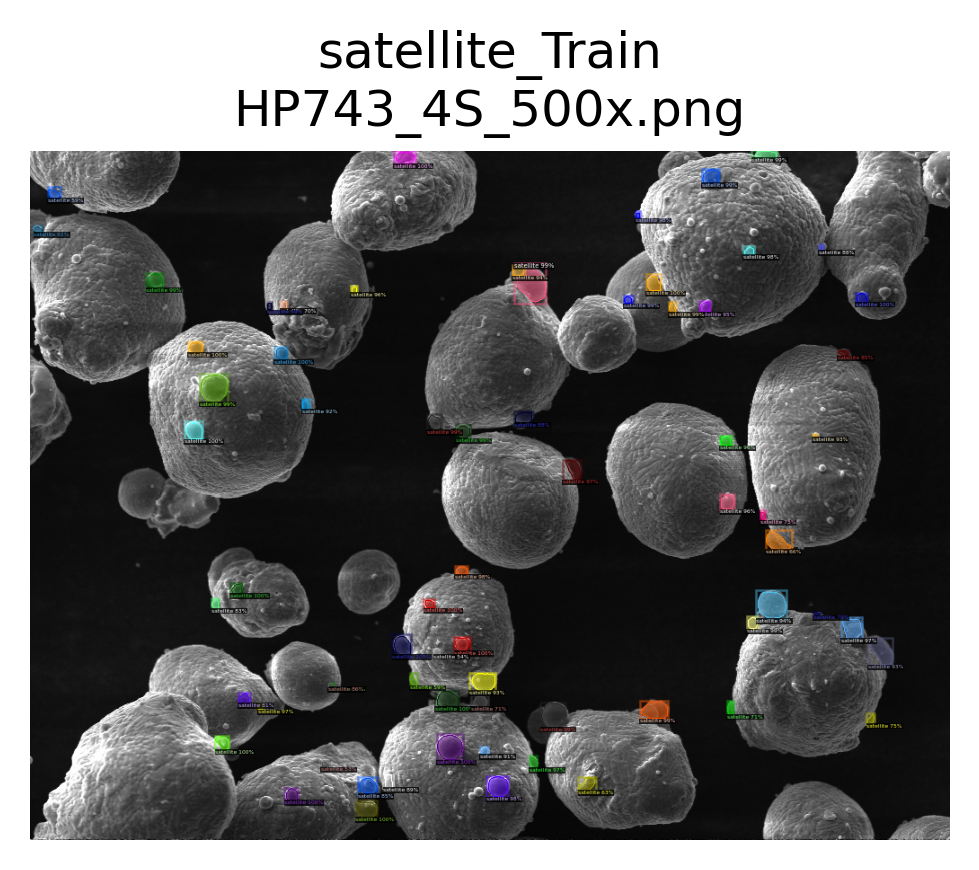

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png
	num_instances: 69
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png


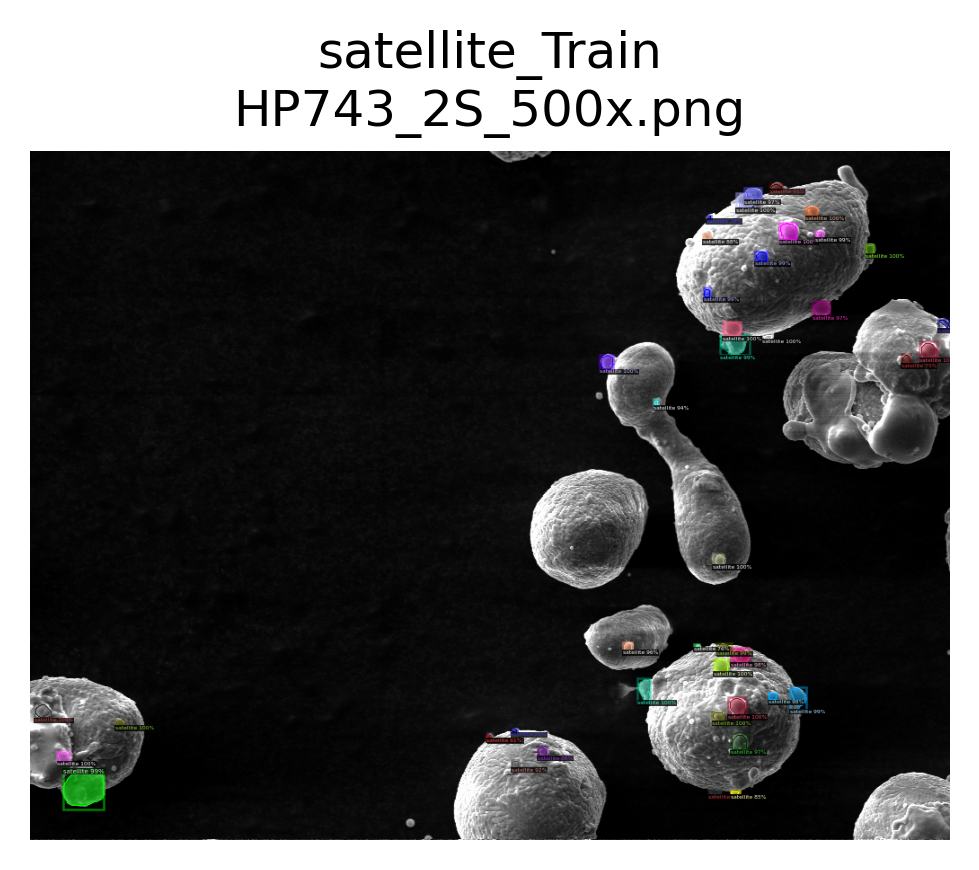

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 43
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png


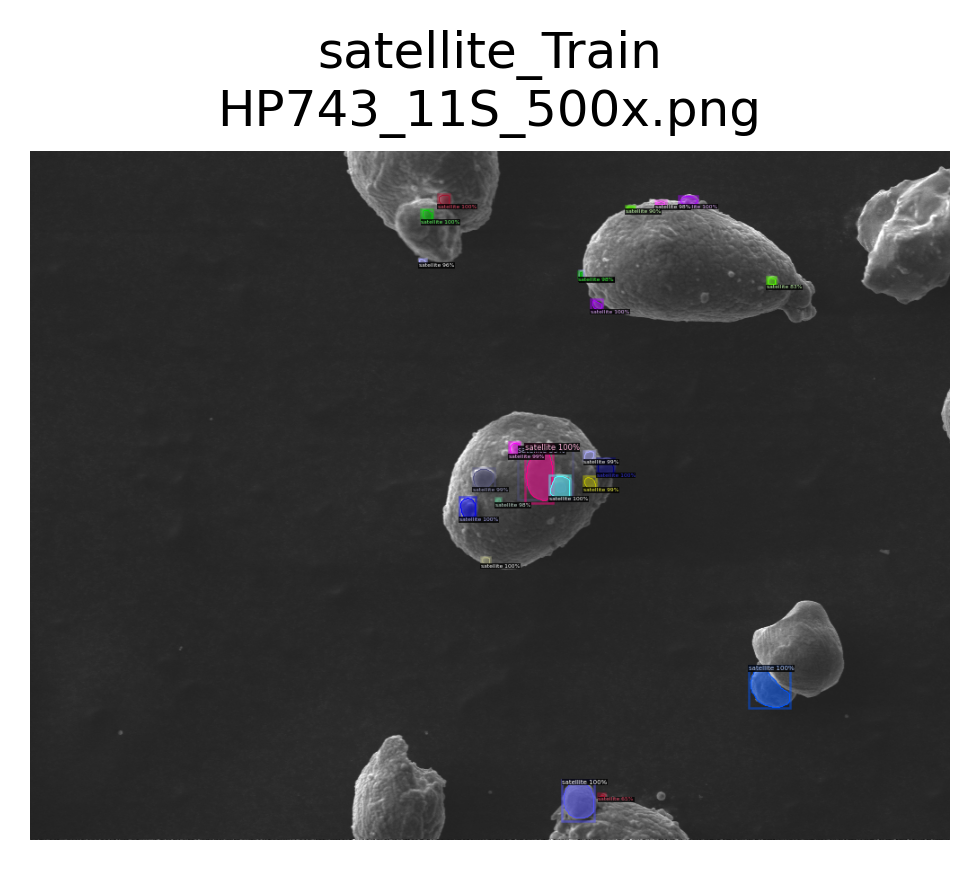

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 24
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png


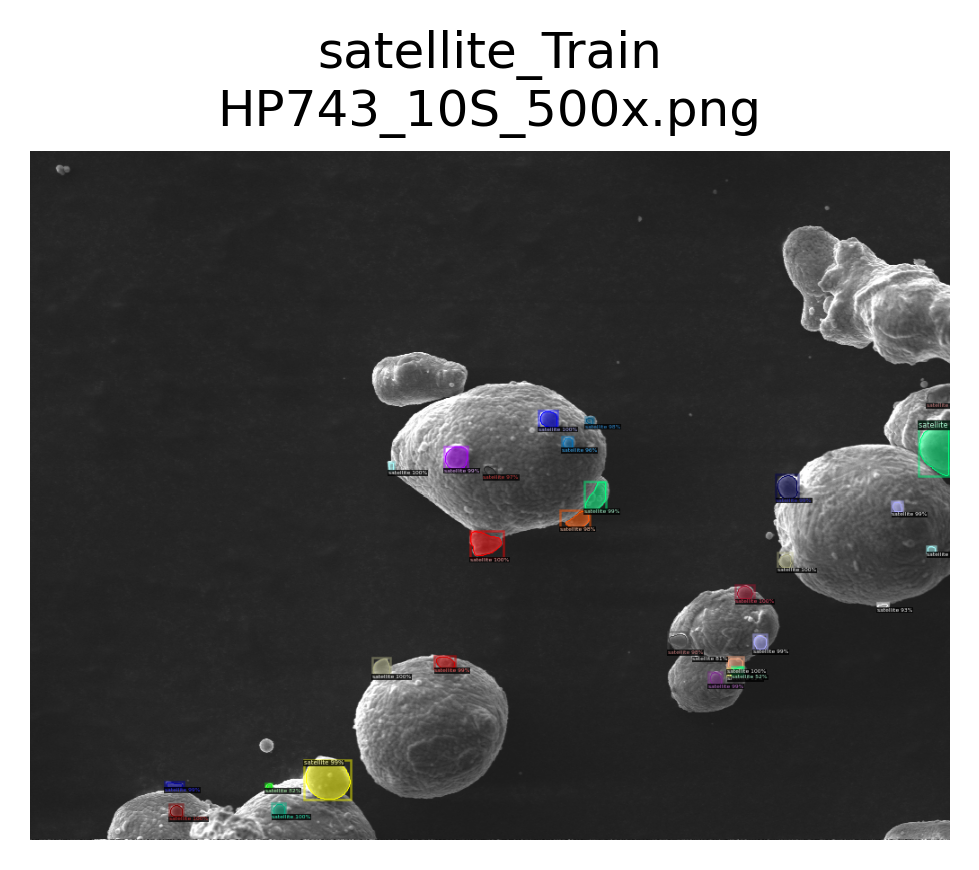

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png
	num_instances: 31
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png


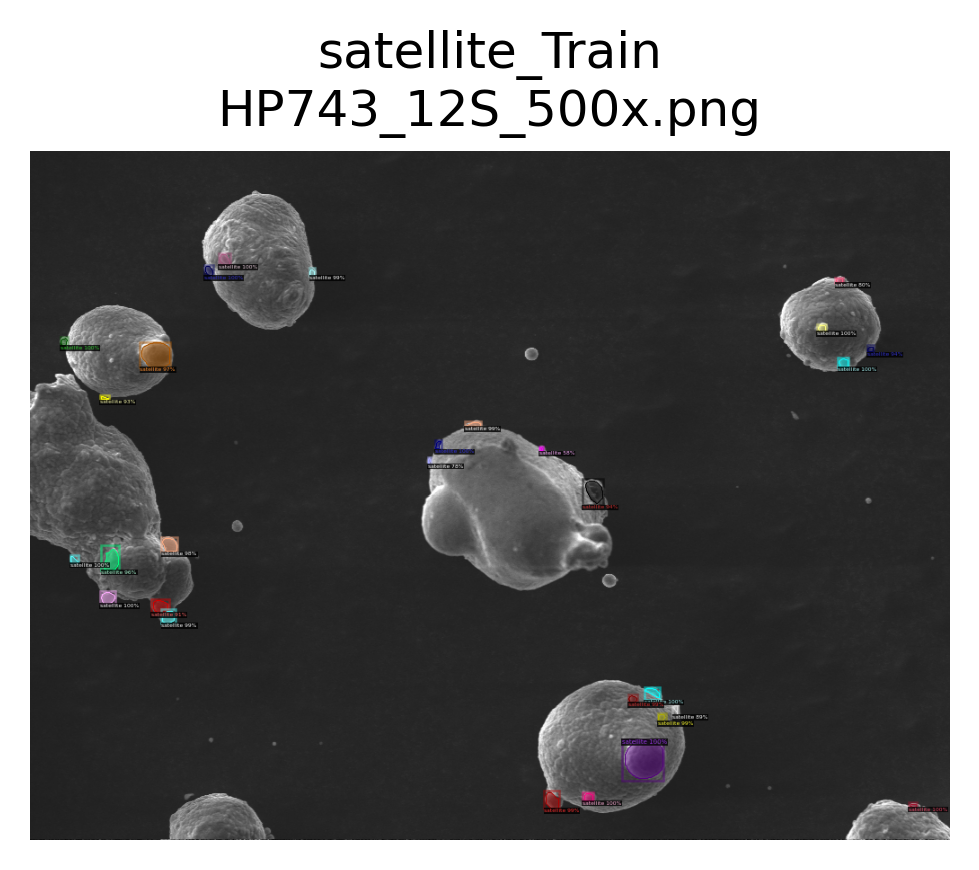

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png
	num_instances: 29
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png


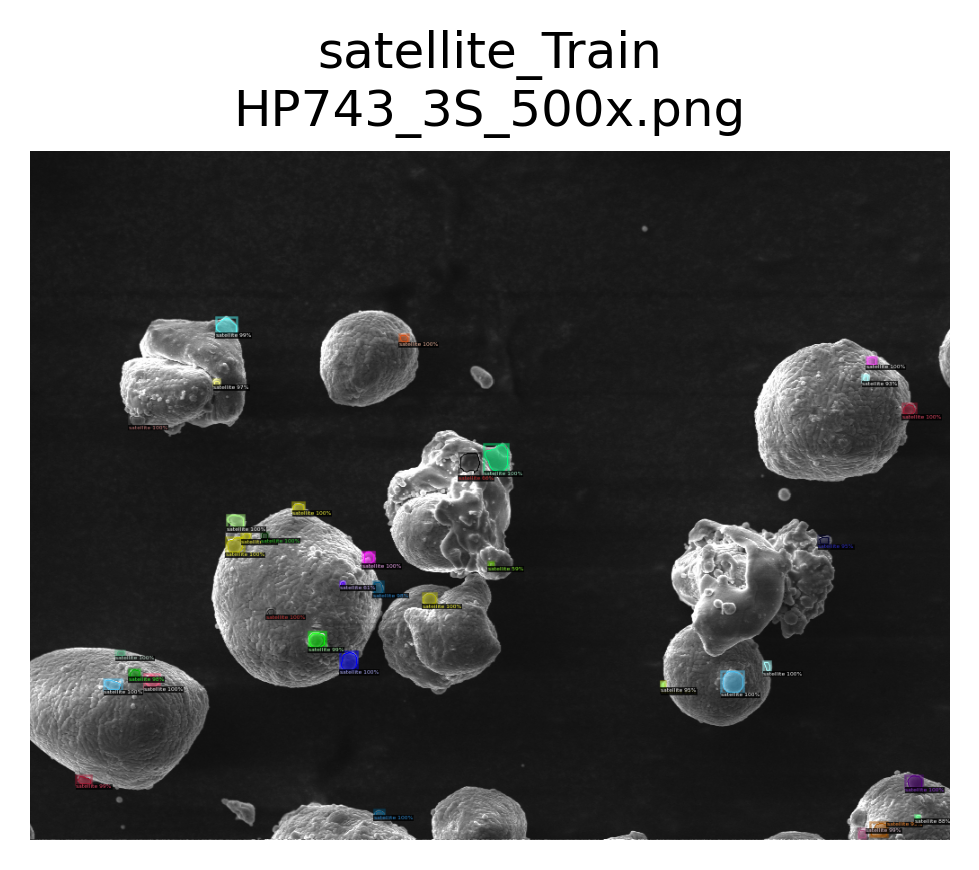

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 37
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png


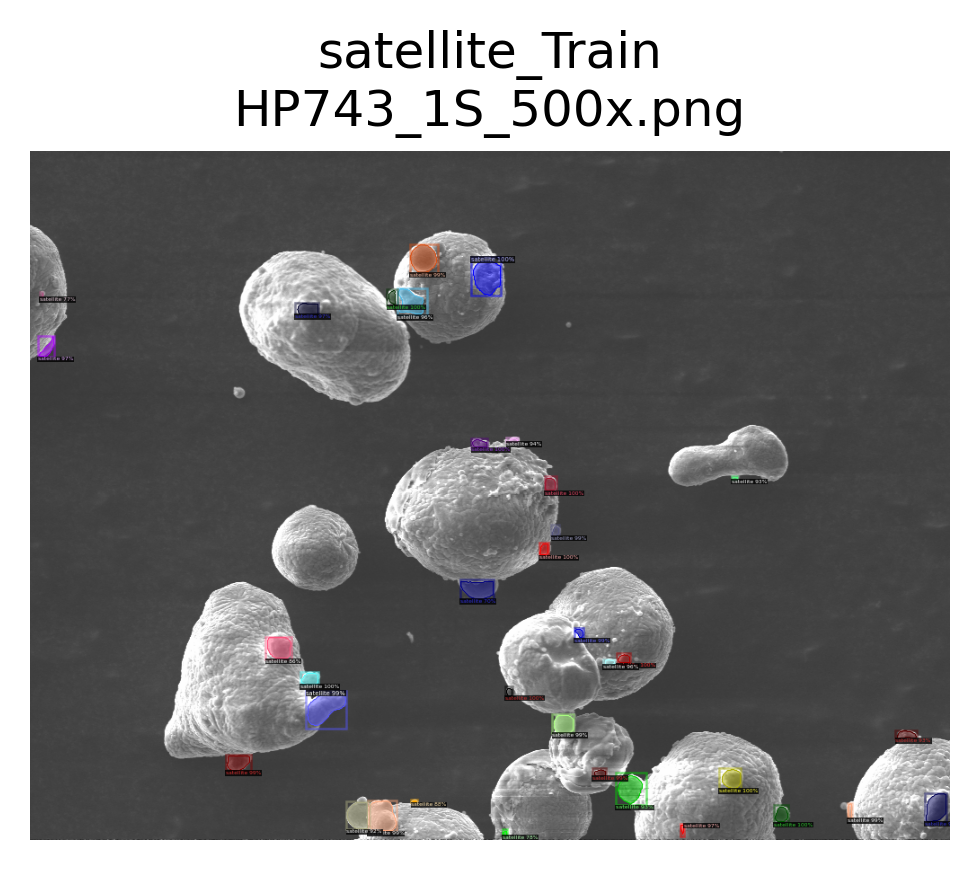

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 35
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png


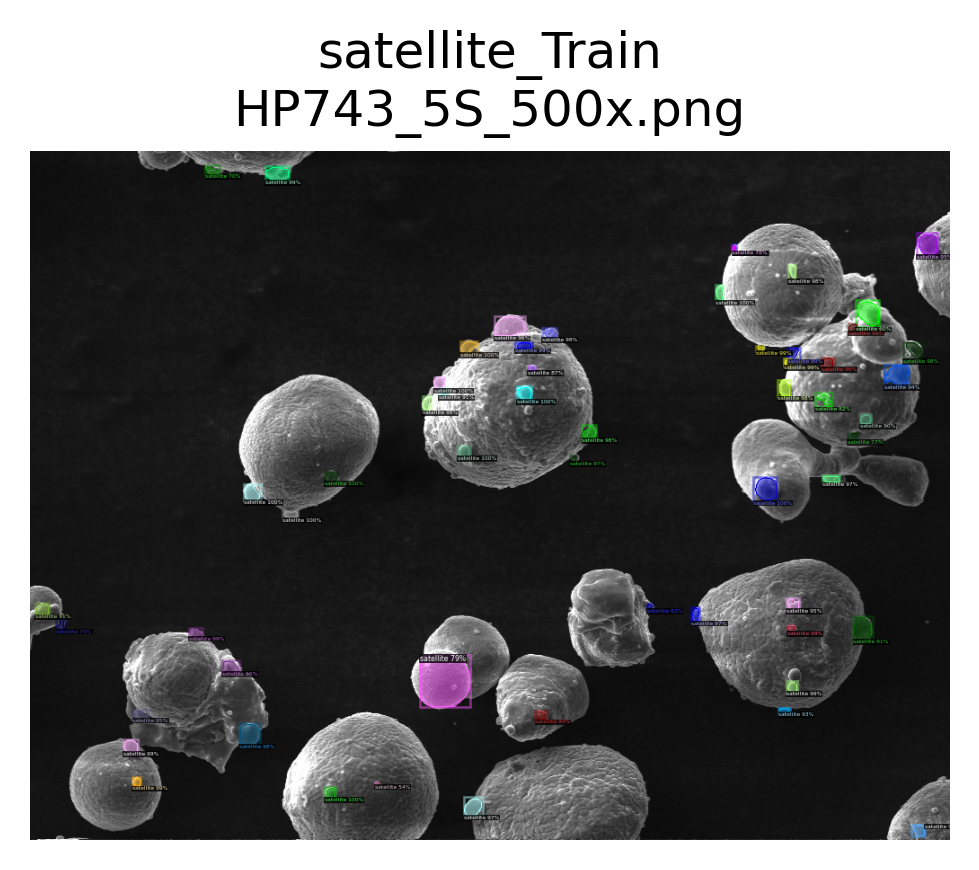

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 57
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png


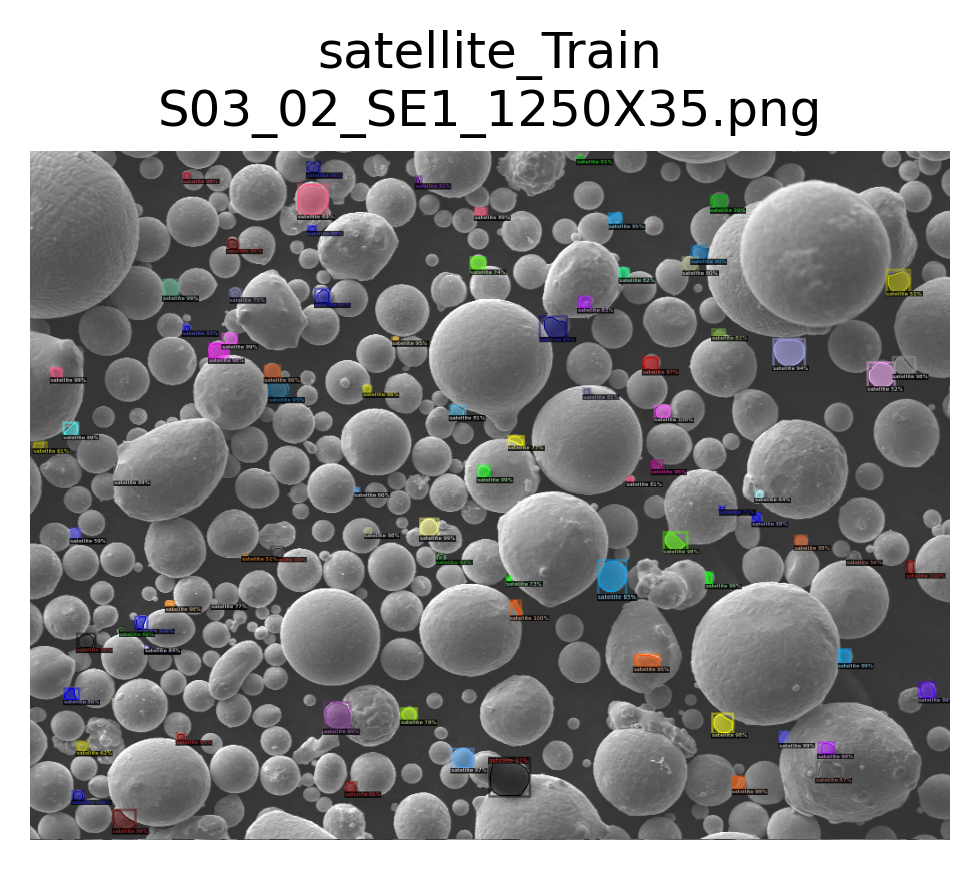

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png
	num_instances: 86
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png


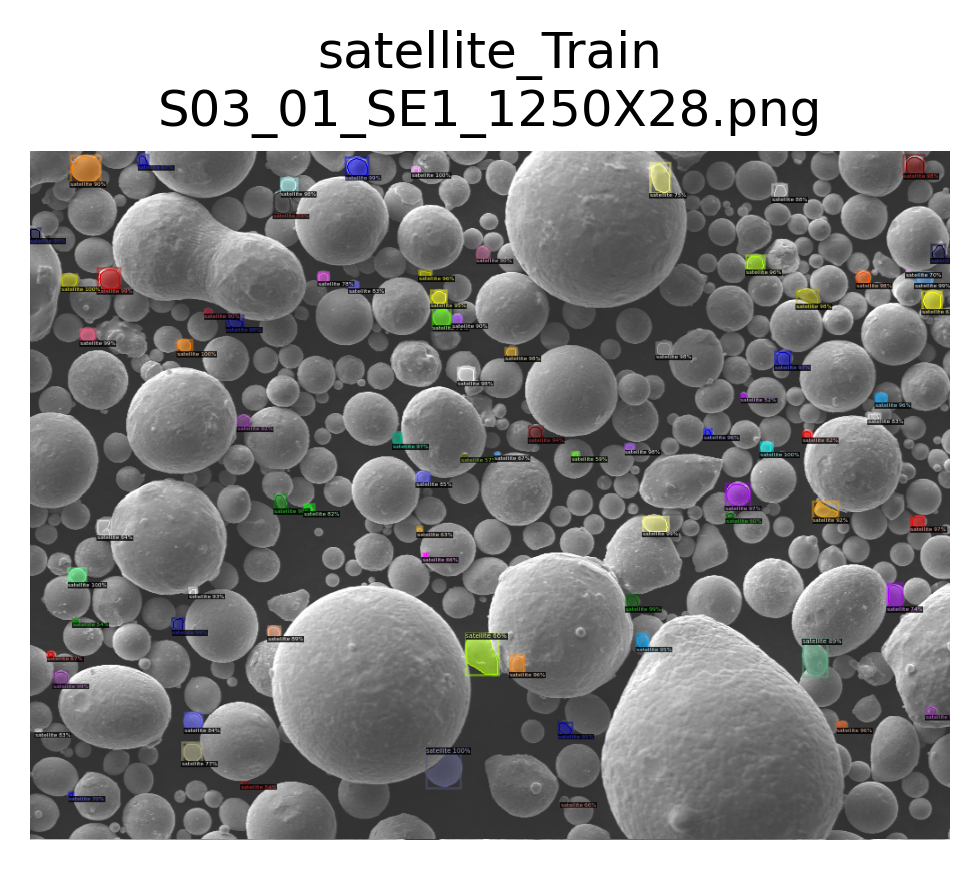

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 81
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png


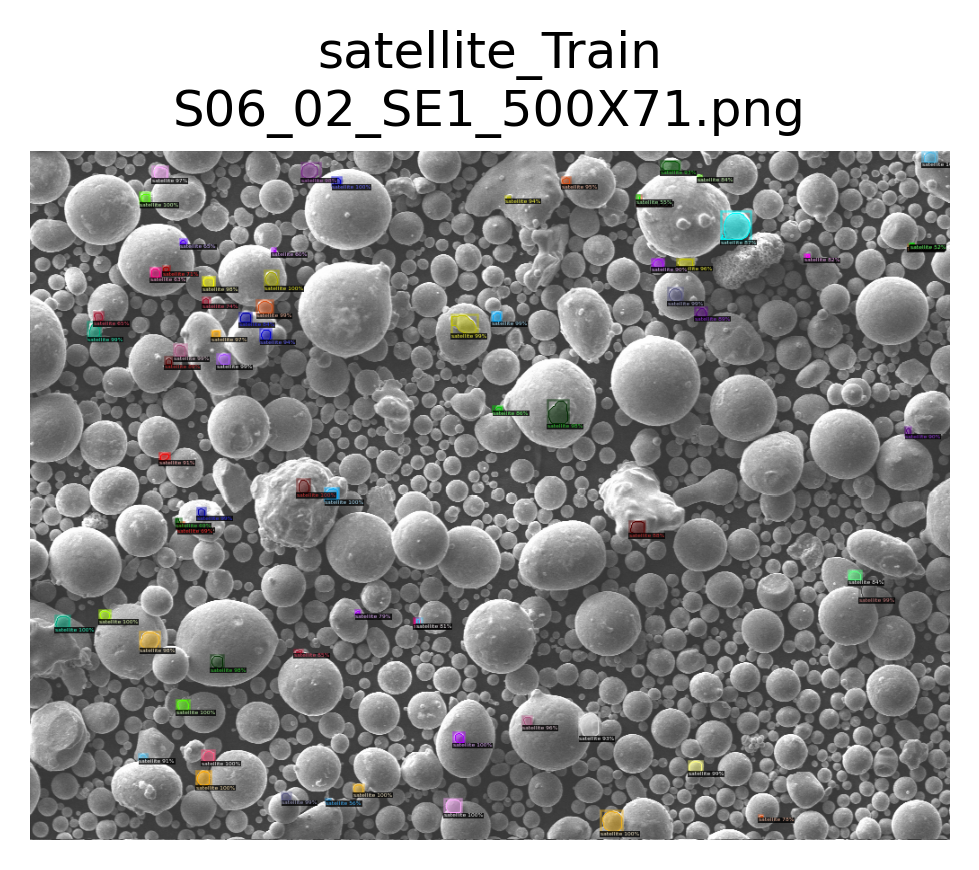

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 74
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png


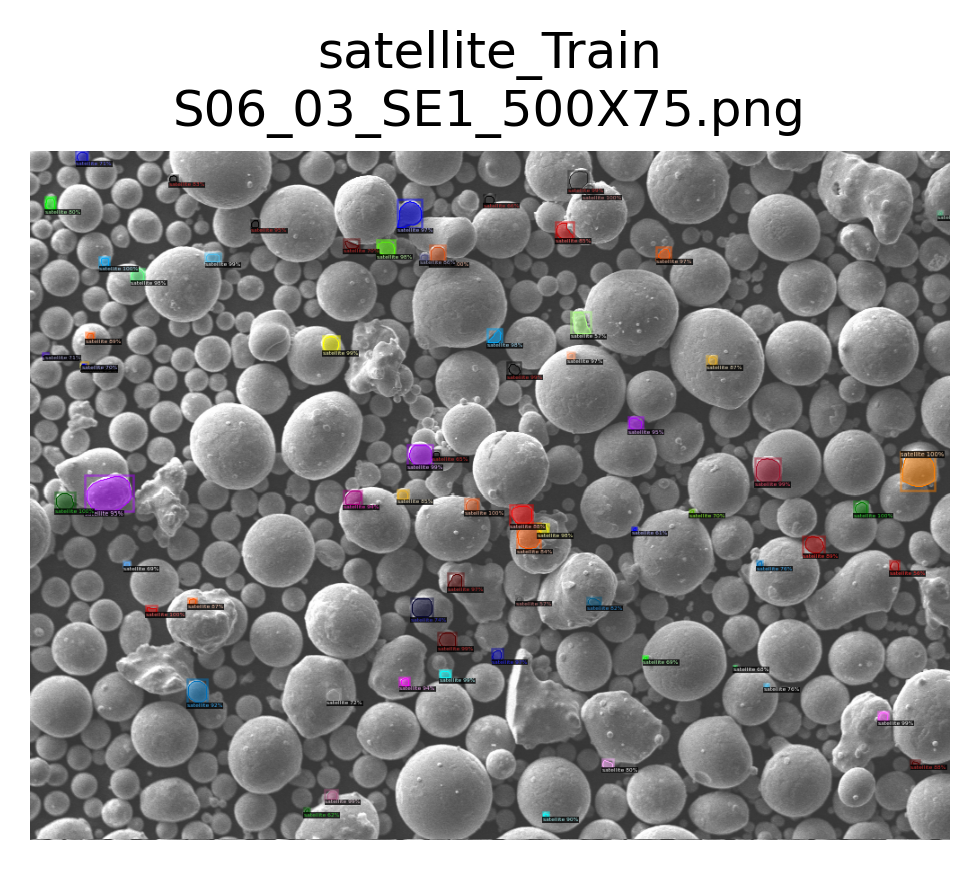

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 71
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png


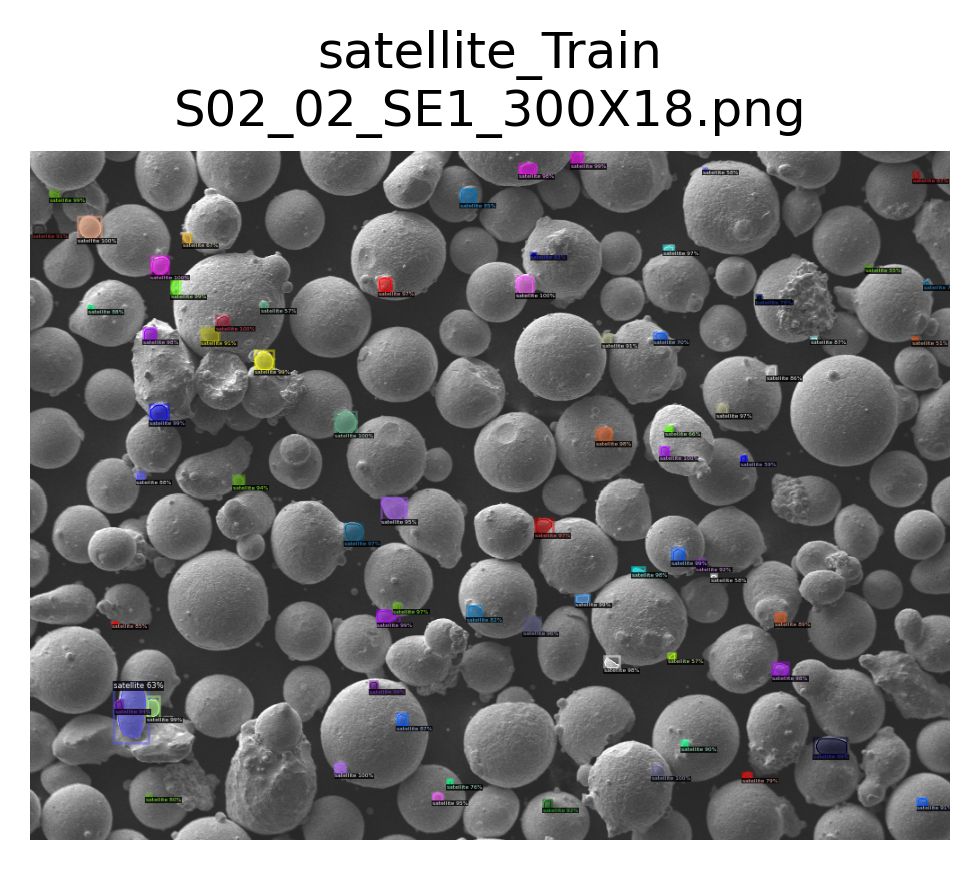

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png
	num_instances: 71
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png


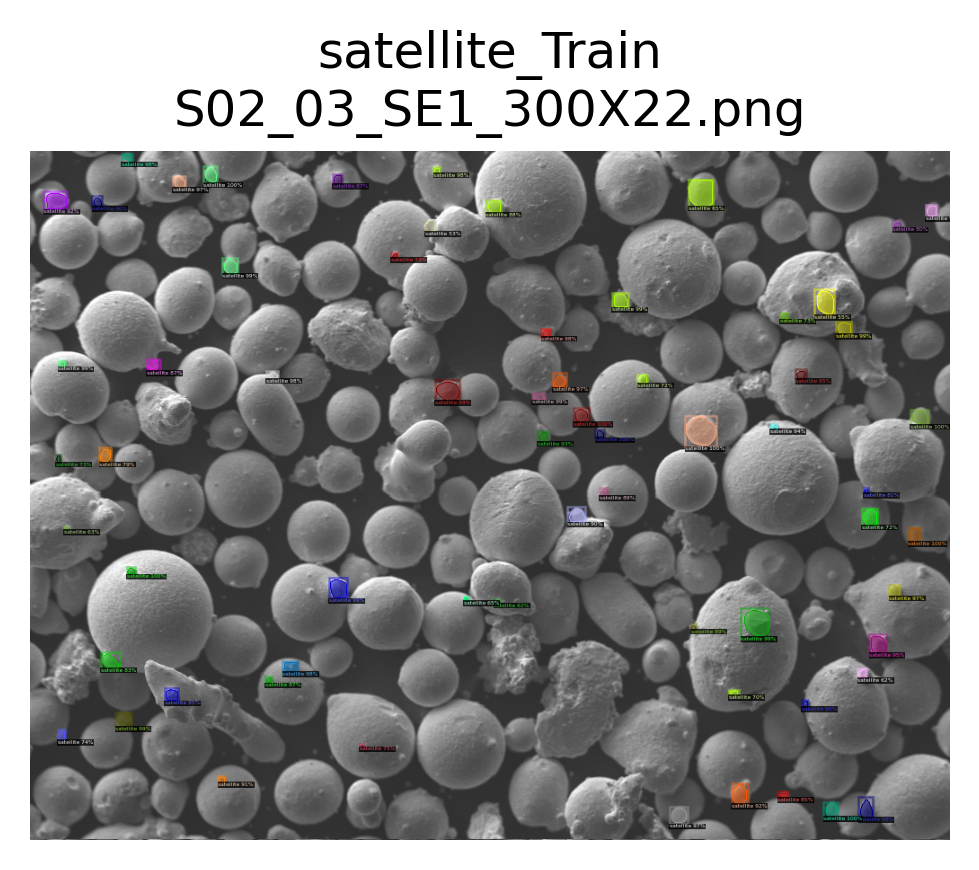

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png
	num_instances: 65
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png


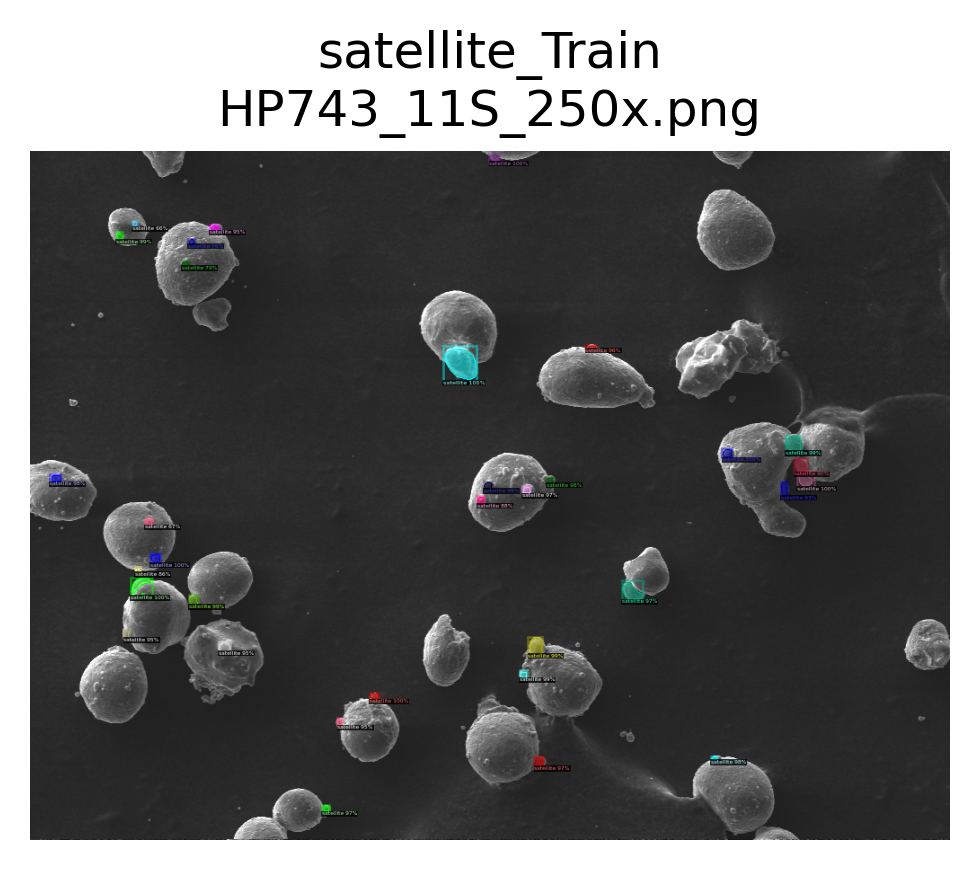

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 33
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png


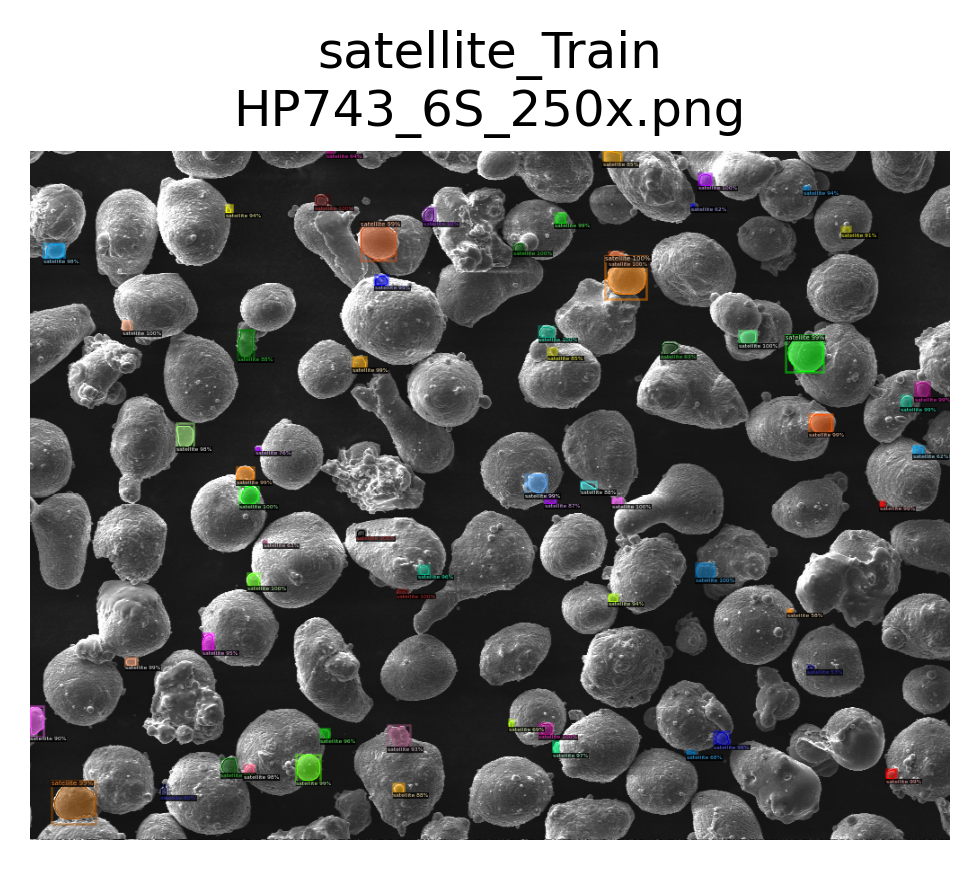

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png
	num_instances: 63
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png


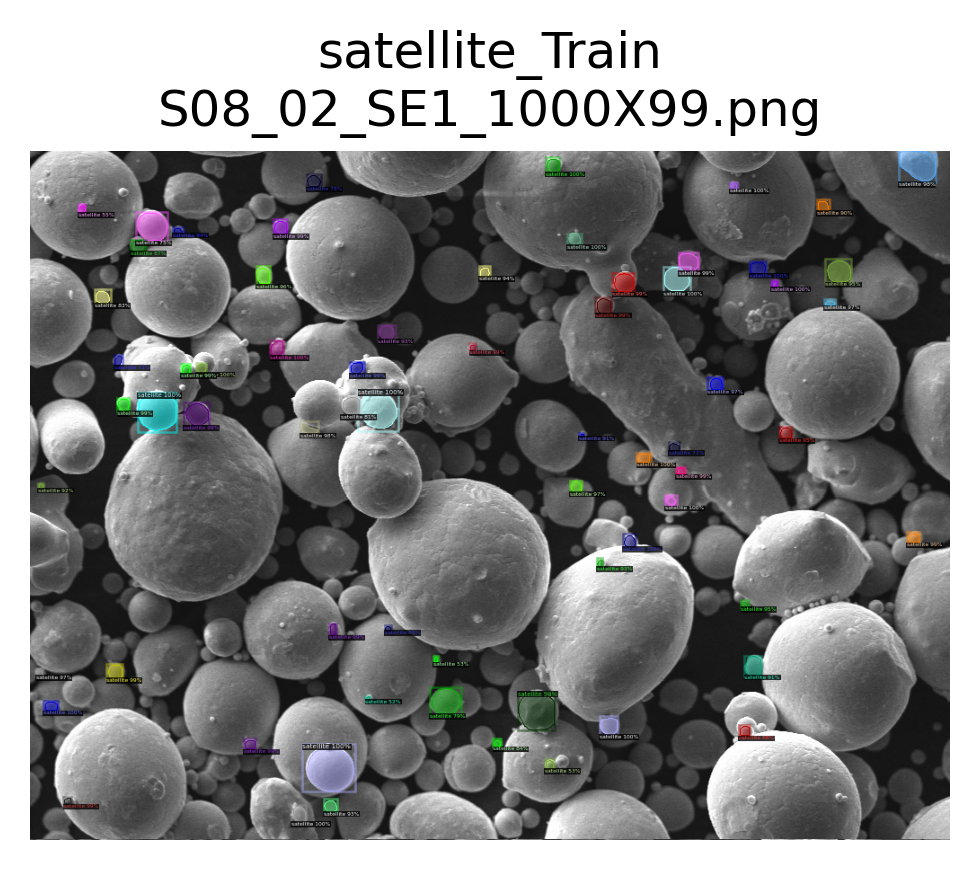

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 67
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png


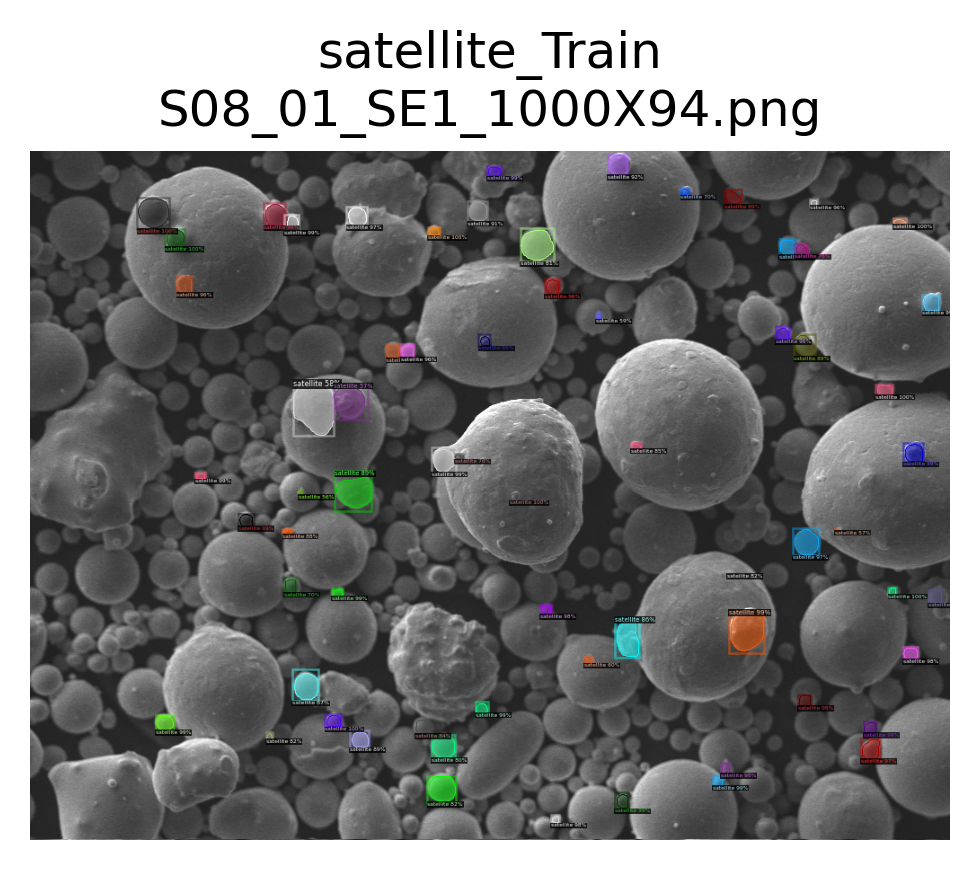

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 66
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png


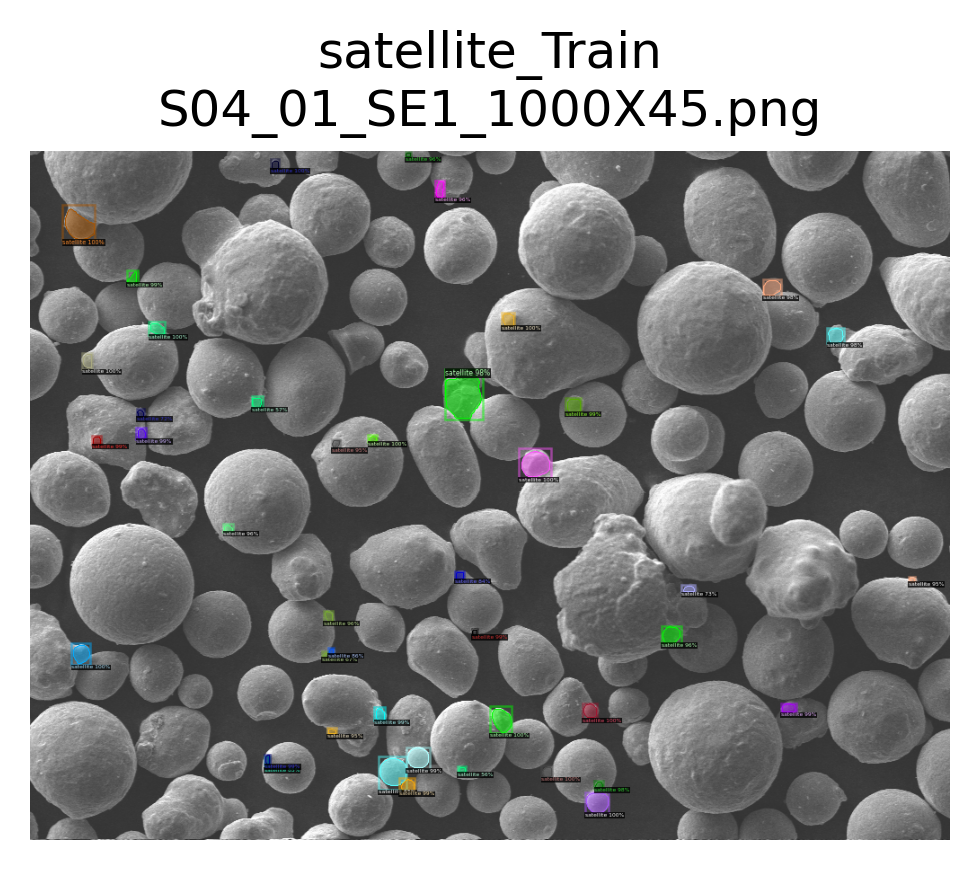

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 43
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png


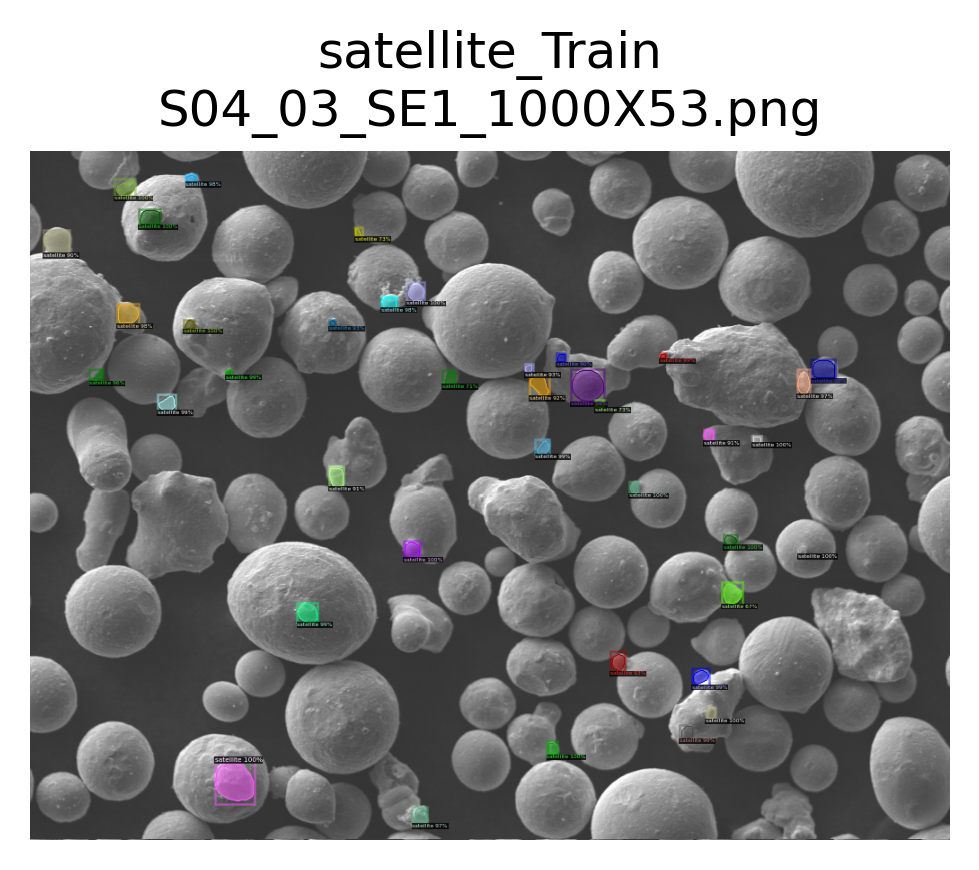

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 39
Dataset: satellite_Val
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png


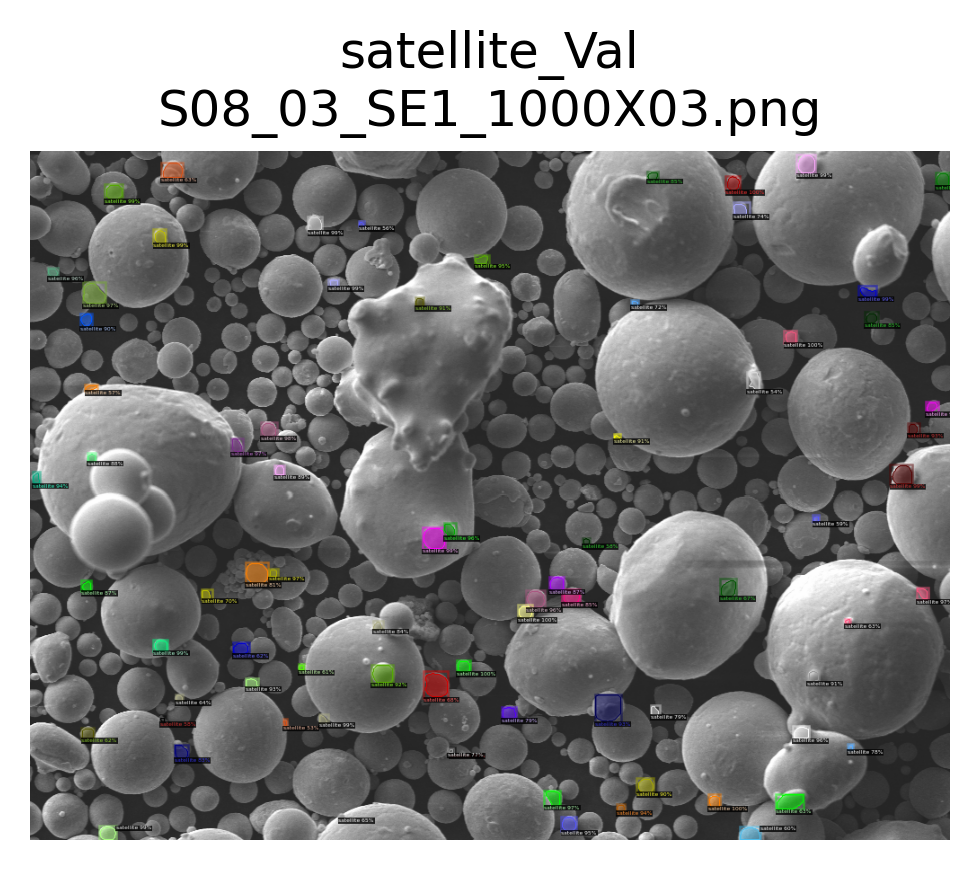

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 77
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png


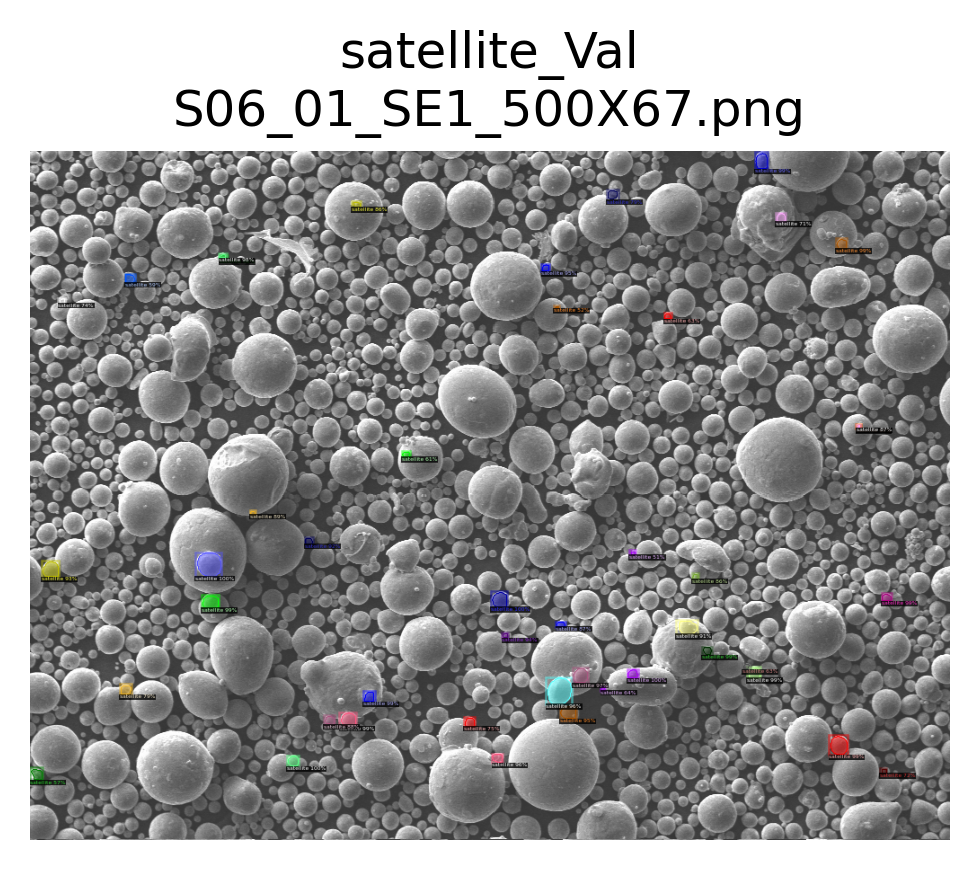

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 45
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png


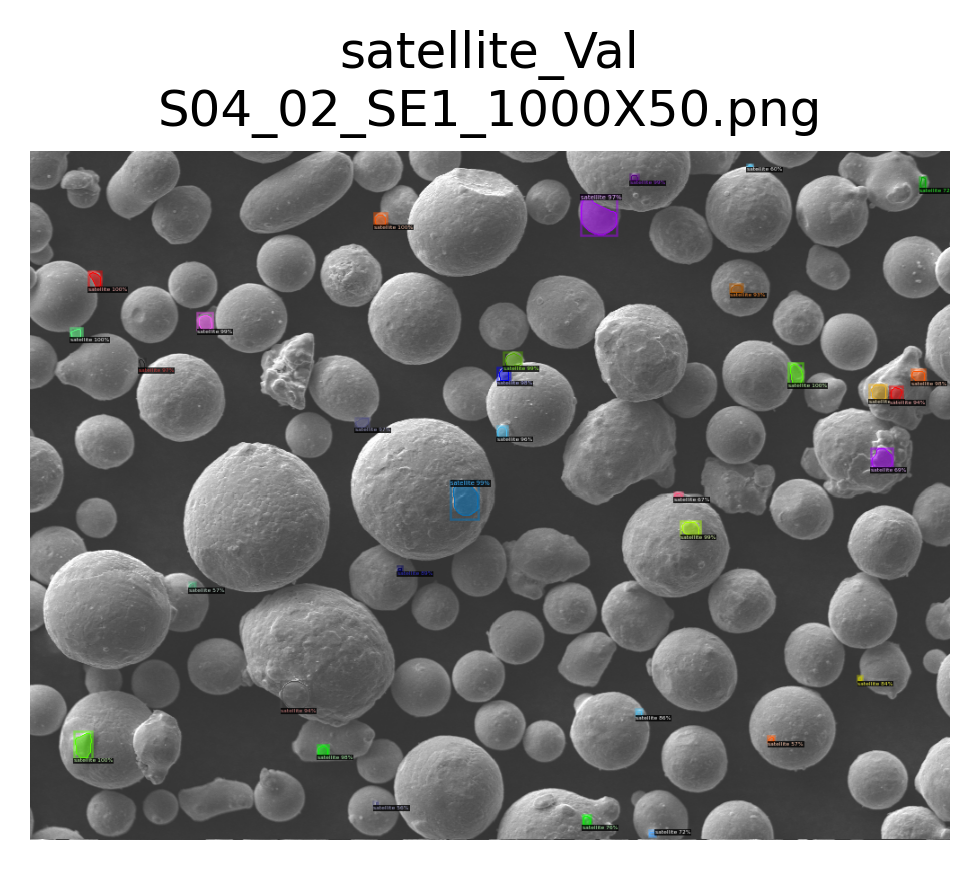

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 33
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png


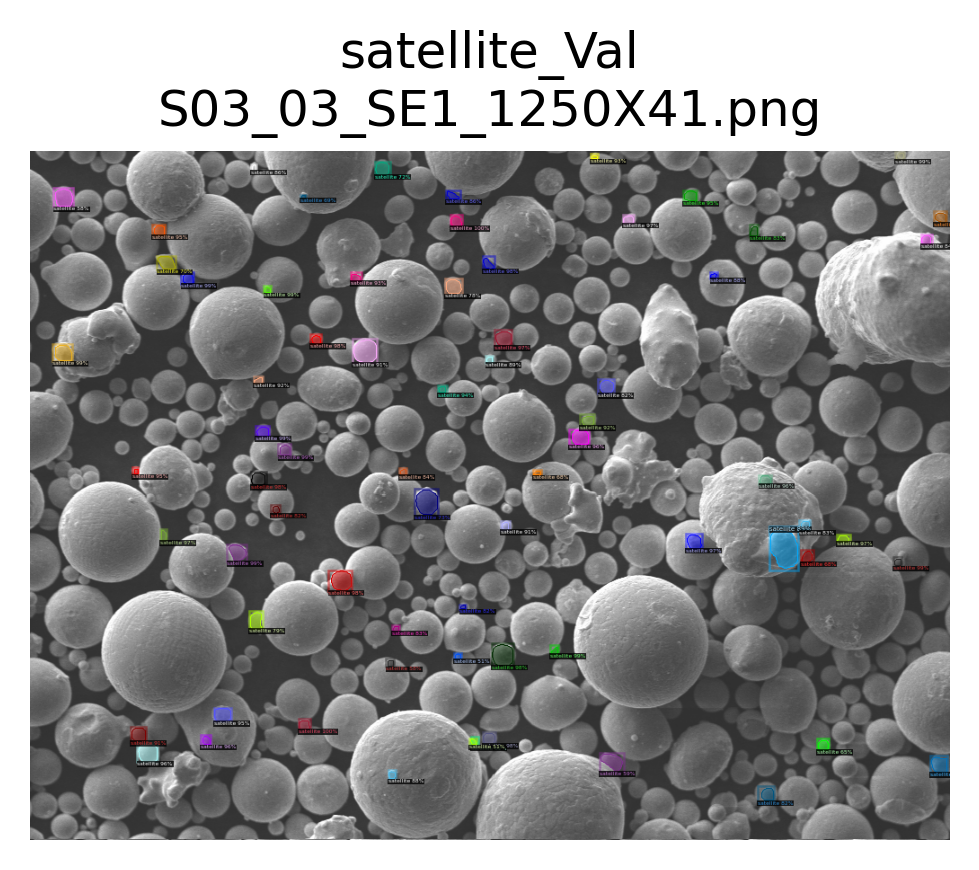

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 70
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png


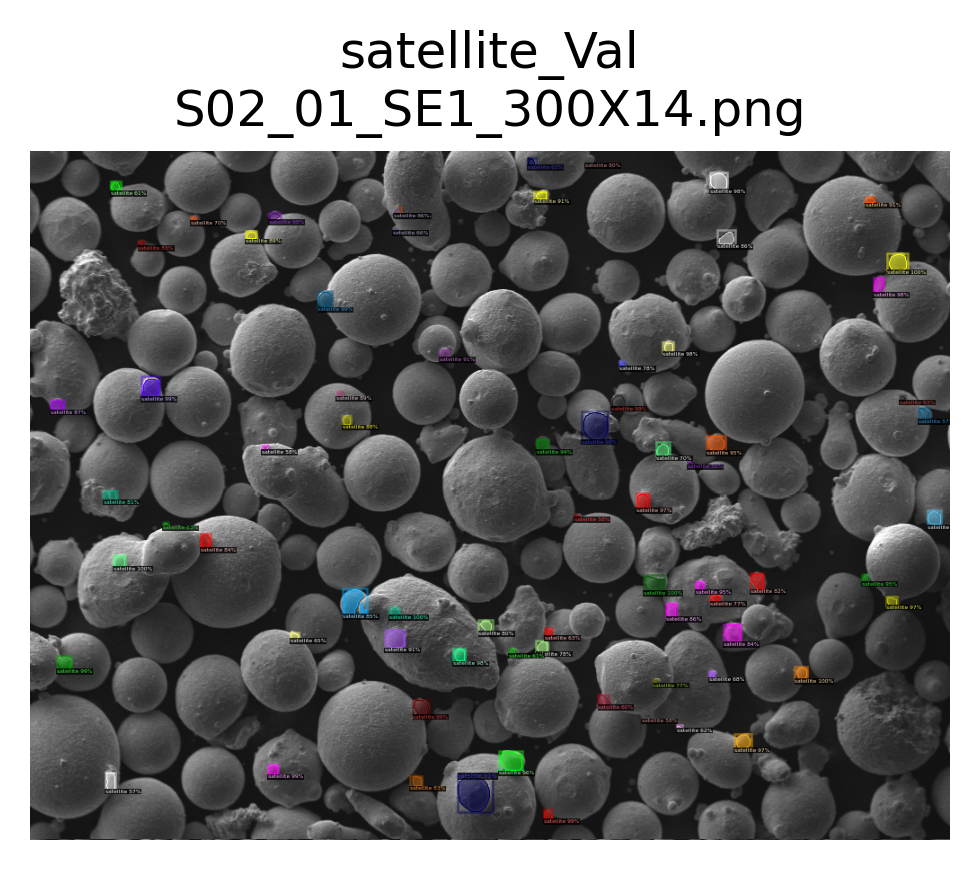

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 72
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png


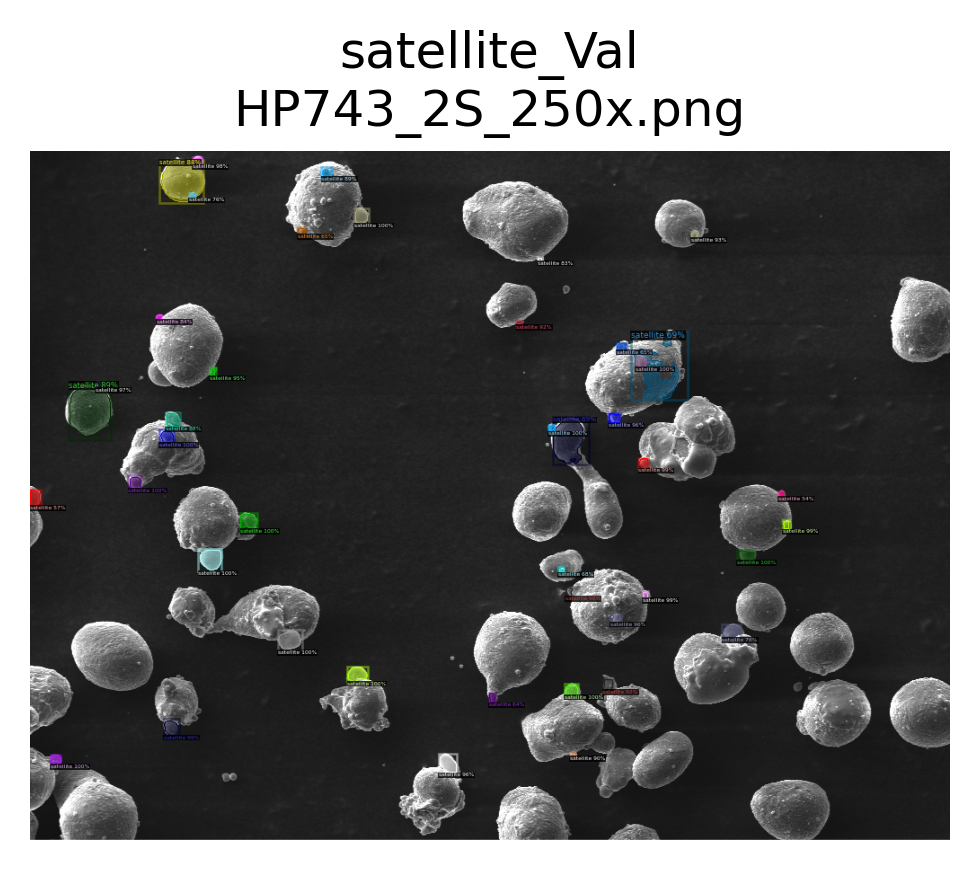

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 43


In [11]:
results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

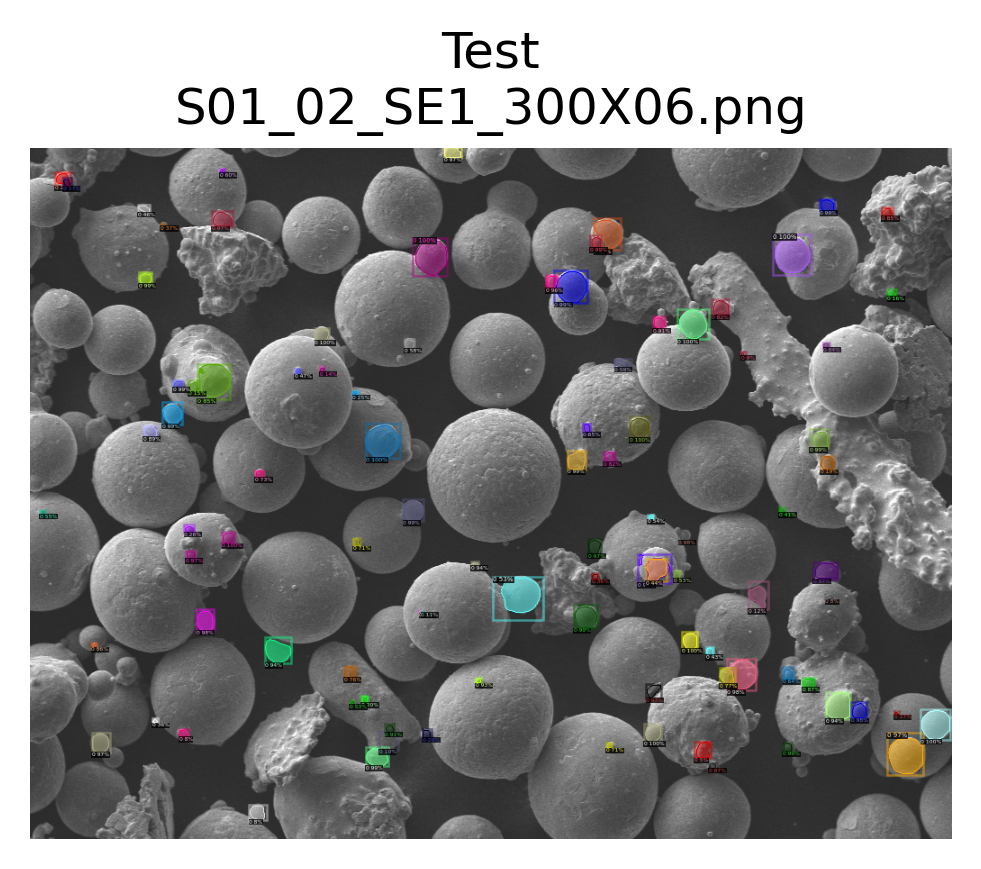

ddict info:
	path: ../data/SEM/S01_02_SE1_300X06.png
	num_instances: 95


In [11]:
img_path = Path('..', 'data','SEM', 'S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image
